In [1]:
import pandas as pd
import numpy as np
def read_ecv(filename,ecv_thresh=0.1):
  fp=open(filename)
  h=next(fp)
  header=h.split("\t")
  bs_prob_idx=header.index("BS.Prob")
  parent_idx=header.index('Parent')
  child_idx=header.index('Child')
  ecv_idx_list=[]
  for i,e in enumerate(header):
    if e[:4]=="ECv:":
      ecv_idx_list.append(i)
  result={}
  for line in fp:
    arr=line.strip().split("\t")
    ecv_list=[float(arr[i]) for i in ecv_idx_list]
    key=(arr[parent_idx],arr[child_idx])
    
    result[key]={}
    result[key]["mean"]=np.mean(ecv_list)
    result[key]["std"]=np.std(ecv_list)
    result[key]["BS.Prob"]=arr[bs_prob_idx]
  return result

def read_expression(filename):
  fp=open(filename)
  g_data={}
  head=next(fp)
  for line in fp:
      arr=line.strip().split("\t")
      g=arr[0]
      v=[float(el) for el in arr[1:]]
      g_data[g]={"mean":np.mean(v),"std":np.std(v)}
  return g_data

def read_result_files(ecv_name,exp_name):
  filename="BN2/ecv_{}.txt".format(ecv_name)
  result_target=read_ecv(filename)
  filename="BN2/ecv_{}_ctrl.txt".format(ecv_name)
  result_ctrl  =read_ecv(filename)
  exp_target=read_expression("data2/{}.txt".format(exp_name))
  exp_ctrl  =read_expression("data2/{}_ctrl.txt".format(exp_name))
  return result_target, result_ctrl, exp_target, exp_ctrl

def build_df(result_target, result_ctrl):
  temp={"s":[],"d":[],"mean":[],"std":[],"mean_ctrl":[],"std_ctrl":[],"diff":[],
        "s_exp_mean":[],"d_exp_mean":[], "s_exp_std":[],"d_exp_std":[]}
  for k,v in result_target.items():
    temp["s"].append(k[0])
    temp["d"].append(k[1])
    temp["mean"].append(v["mean"])
    temp["std"].append(v["std"])
    v2=result_ctrl[k]
    temp["mean_ctrl"].append(v2["mean"])
    temp["std_ctrl"].append(v2["std"])
    temp["diff"].append(v["mean"]-v2["mean"])
    temp["s_exp_mean"].append(exp_target[k[0]]["mean"])
    temp["d_exp_mean"].append(exp_target[k[1]]["mean"])
    temp["s_exp_std"].append(exp_target[k[0]]["std"])
    temp["d_exp_std"].append(exp_target[k[1]]["std"])
  df=pd.DataFrame(temp)
  return df

#ecv_name="full_logtpm_inc_cortex_logtpm"
#exp_name="inc_cortex_logtpm"
#result_target, result_ctrl, exp_target, exp_ctrl =read_result_files(ecv_name,exp_name)
#df=build_df(result_target, result_ctrl)

In [5]:
df=read_ecv("ecv_all__Aorta.txt")

ValueError: could not convert string to float: ''

In [1]:
! ls ecv_all2

In [2]:
! ls bs_all2

result.ing.000001  result.ing.000027  result.ing.000053  result.ing.000079
result.ing.000002  result.ing.000028  result.ing.000054  result.ing.000080
result.ing.000003  result.ing.000029  result.ing.000055  result.ing.000081
result.ing.000004  result.ing.000030  result.ing.000056  result.ing.000082
result.ing.000005  result.ing.000031  result.ing.000057  result.ing.000083
result.ing.000006  result.ing.000032  result.ing.000058  result.ing.000084
result.ing.000007  result.ing.000033  result.ing.000059  result.ing.000085
result.ing.000008  result.ing.000034  result.ing.000060  result.ing.000086
result.ing.000009  result.ing.000035  result.ing.000061  result.ing.000087
result.ing.000010  result.ing.000036  result.ing.000062  result.ing.000088
result.ing.000011  result.ing.000037  result.ing.000063  result.ing.000089
result.ing.000012  result.ing.000038  result.ing.000064  result.ing.000090
result.ing.000013  result.ing.000039  result.ing.000065  result.ing.000091
result.ing.000014  result

In [6]:
! head -n 30 result_all2.txt

Parent	Child	id	parent.id	child.id	edgeScore	BS.Prob	BS.Direction	bspline	gain	parent.type	child.type	parent.hubness	child.hubness	parent.BS.HubIndex	child.BS.HubIndex	parent.mean	child.mean	parent.variance	child.variance
Sept4	Sox17	1	365	1	0.0500000	0.0500000	0.6000000	0.0064392:2.6730638:0.0469053:0.0818125:0.1191242:0.1661265:0.2191814:0.2625443:0.2977276:0.3268227:0.3516029:0.3726989:0.3904129:0.4051206:0.4171979:0.4270205:0.4349643:0.4414049:0.4467181:0.4512799:0.4554658:0.4595891	25.6767295	real	real	13	10	1.7400000	1.0700000	0.0000000	0.0013167	0.0024875	0.0012523
Emcn	Sox17	2	1477	1	0.0500000	0.0500000	0.8000000	0.0004308:1.2764286:-0.0181215:0.0071946:0.0569956:0.0490988:0.1108958:0.1528587:0.1548964:0.2075291:0.3425731:0.5082682:0.5903862:0.6035177:0.6021605:0.5900980:0.5690817:0.5487161:0.5416344:0.5396796:0.5373043:0.5348481	45.7935580	real	real	16	10	1.6200000	1.0700000	0.0000000	0.0013167	0.0020313	0.0012523
Tie1	Sox17	3	1563	1	0.1000000	0.1000000	0.7000000	0.0007975:1.3

In [16]:
import pandas as pd
df=pd.read_csv("result_all3.txt",sep="\t")
df

,Parent,Child,id,parent.id,child.id,edgeScore,BS.Prob,BS.Direction,bspline,gain,parent.type,child.type,parent.hubness,child.hubness,parent.BS.HubIndex,child.BS.HubIndex,parent.mean,child.mean,parent.variance,child.variance
0,Tie1,Sox17,1,1563,1,0.097,0.097,0.783505,0.0008057:1.1624292:-0.0208376:0.0139739:0.057...,55.194766,real,real,14,5,2.432,0.708,0.002259,0.000997,0.001651,0.001039
1,Rasip1,Sox17,2,2045,1,0.114,0.114,0.570175,0.0079438:1.0478846:-0.0323561:-0.0038756:0.02...,41.158515,real,real,8,5,0.849,0.708,0.010341,0.000997,0.004411,0.001039
2,Esam,Sox17,3,2329,1,0.536,0.536,0.936567,0.0065743:1.5823585:-0.0180397:0.0017182:0.041...,43.815886,real,real,16,5,2.838,0.708,0.000671,0.000997,0.002392,0.001039
3,Ube2c,Mrpl15,4,1323,2,0.229,0.229,0.886463,0.0104265:0.9490240:0.1066300:0.2234706:0.3351...,16.788183,real,real,9,8,1.799,0.903,0.000000,0.000000,0.000611,0.002255
4,Pmf1,Mrpl15,5,1393,2,0.322,0.322,0.881988,0.0745607:0.9769841:0.1878400:0.2374250:0.2812...,19.302089,real,real,5,8,0.928,0.903,0.000000,0.000000,0.002168,0.002255
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12071,Jmjd8,Tmsb4x,12072,928,2488,0.053,0.053,0.943396,0.1519452:0.7185136:1.2109350:1.1300381:1.0491...,12.291677,real,real,8,2,0.960,0.334,0.000000,0.000000,0.001419,0.020599
12072,Zfp523,Tmsb4x,12073,935,2488,0.106,0.106,0.962264,0.0920120:0.6417622:1.7267691:1.6484926:1.5698...,10.453787,real,real,15,2,1.351,0.334,0.000221,0.000000,0.000787,0.020599
12073,Notch2,Tmsb4x,12074,1436,2488,0.097,0.097,0.958763,0.0794185:1.1079149:0.6170079:0.7863205:0.9512...,10.900811,real,real,2,2,0.748,0.334,0.000000,0.000000,0.005672,0.020599
12074,Uox,Tmsb4x,12075,1487,2488,0.054,0.054,0.814815,0.0004973:2.0619171:4.8456120:1.6401681:-1.234...,13.763947,real,real,2,2,0.582,0.334,0.000162,0.000000,0.000502,0.020599


(array([3.659e+03, 2.174e+03, 1.409e+03, 1.018e+03, 7.250e+02, 5.450e+02,
        4.260e+02, 3.260e+02, 2.740e+02, 1.950e+02, 1.730e+02, 1.600e+02,
        1.260e+02, 1.180e+02, 8.800e+01, 7.900e+01, 7.800e+01, 6.700e+01,
        4.900e+01, 5.200e+01, 4.000e+01, 3.300e+01, 2.700e+01, 3.200e+01,
        2.000e+01, 2.100e+01, 2.100e+01, 1.300e+01, 1.900e+01, 8.000e+00,
        1.000e+01, 7.000e+00, 8.000e+00, 7.000e+00, 8.000e+00, 7.000e+00,
        5.000e+00, 7.000e+00, 7.000e+00, 3.000e+00, 2.000e+00, 2.000e+00,
        2.000e+00, 1.000e+00, 5.000e+00, 5.000e+00, 1.000e+00, 6.000e+00,
        5.000e+00, 3.000e+00]),
 array([0.05   , 0.06898, 0.08796, 0.10694, 0.12592, 0.1449 , 0.16388,
        0.18286, 0.20184, 0.22082, 0.2398 , 0.25878, 0.27776, 0.29674,
        0.31572, 0.3347 , 0.35368, 0.37266, 0.39164, 0.41062, 0.4296 ,
        0.44858, 0.46756, 0.48654, 0.50552, 0.5245 , 0.54348, 0.56246,
        0.58144, 0.60042, 0.6194 , 0.63838, 0.65736, 0.67634, 0.69532,
        0.7143 , 0.73

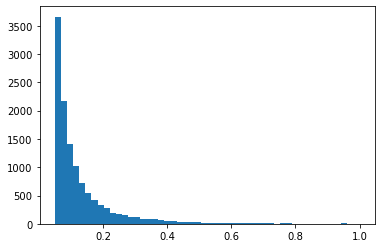

In [17]:
import matplotlib.pyplot as plt
plt.hist(df["BS.Prob"],bins=50)


In [18]:
df2=df[df["BS.Prob"]>0.2]
df2

,Parent,Child,id,parent.id,child.id,edgeScore,BS.Prob,BS.Direction,bspline,gain,parent.type,child.type,parent.hubness,child.hubness,parent.BS.HubIndex,child.BS.HubIndex,parent.mean,child.mean,parent.variance,child.variance
2,Esam,Sox17,3,2329,1,0.536,0.536,0.936567,0.0065743:1.5823585:-0.0180397:0.0017182:0.041...,43.815886,real,real,16,5,2.838,0.708,0.000671,0.000997,0.002392,0.001039
3,Ube2c,Mrpl15,4,1323,2,0.229,0.229,0.886463,0.0104265:0.9490240:0.1066300:0.2234706:0.3351...,16.788183,real,real,9,8,1.799,0.903,0.000000,0.000000,0.000611,0.002255
4,Pmf1,Mrpl15,5,1393,2,0.322,0.322,0.881988,0.0745607:0.9769841:0.1878400:0.2374250:0.2812...,19.302089,real,real,5,8,0.928,0.903,0.000000,0.000000,0.002168,0.002255
5,Timm44,Mrpl15,6,2178,2,0.364,0.364,0.620879,0.2434868:0.7914561:0.2047996:0.2275307:0.2511...,13.982836,real,real,13,8,1.862,0.903,0.002640,0.000000,0.001341,0.002255
16,Pip4k2c,Stau2,17,245,5,0.256,0.256,0.742188,0.1896142:0.7201734:0.0816850:0.0795004:0.0784...,20.967298,real,real,8,2,0.674,0.633,0.000000,0.000000,0.001277,0.000707
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12032,Ldb3,Smpx,12033,639,2481,0.201,0.201,0.527363,0.0006445:0.4684322:0.0009103:-0.0026331:0.008...,79.792306,real,real,2,3,0.245,0.430,0.000000,0.000000,0.000194,0.000070
12046,Guca2b,S100g,12047,1568,2484,0.219,0.219,0.666667,0.0002612:2.3821621:-0.0534819:0.0099330:0.077...,121.495640,real,real,5,2,0.546,0.305,0.000310,0.000266,0.000314,0.000462
12049,Car15,Tmem27,12050,834,2485,0.346,0.346,0.586705,0.0054881:0.6707753:-0.0928296:-0.0120452:0.06...,85.339131,real,real,5,2,0.599,0.451,0.001683,0.000135,0.000036,0.000463
12064,Omg,Trappc2,12065,343,2487,0.269,0.269,0.925651,0.0017425:2.6127248:-1.9419997:0.0994064:1.926...,29.504003,real,real,5,12,1.049,1.195,0.000141,0.000000,0.000311,0.001335


In [19]:
import networkx as nx
import matplotlib.pyplot as plt

filename="network_all.png"

Gd=nx.DiGraph()
G=nx.Graph()
edges=[]
weights=[]
for i, r in df2.iterrows():
    src=r["Parent"]
    dest=r["Child"]
    edges.append((src,dest))
    weight=1
    weights.append(weight)
    Gd.add_edge(src,dest,weight=weight)
    G.add_edge(src,dest,weight=weight)


In [20]:
gg_list=[]
for gg in nx.connected_components(G):
    gg_list.append(len(gg))


(array([256.,   7.,   1.,   2.,   0.,   0.,   1.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   1.]),
 array([  2.  ,  14.98,  27.96,  40.94,  53.92,  66.9 ,  79.88,  92.86,
        105.84, 118.82, 131.8 , 144.78, 157.76, 170.74, 183.72, 196.7 ,
        209.68, 222.66, 235.64, 248.62, 261.6 , 274.58, 287.56, 300.54,
        313.52, 326.5 , 339.48, 352.46, 365.44, 378.42, 391.4 , 404.38,
        417.36, 430.34, 443.32, 456.3 , 469.28, 482.26, 495.24, 508.22,
        521.2 , 534.18, 547.16, 560.14, 573.12, 586.1 , 599.08, 612.06,
        625.04, 638.02, 651.  ]),
 <a list of 50 Patch objects>)

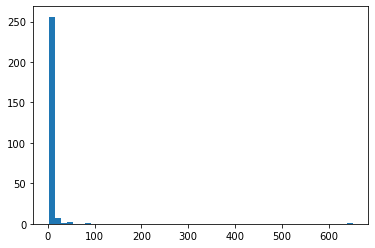

In [21]:
plt.hist(gg_list,bins=50)

In [25]:
import networkx as nx

target_G_list=[]
for gg in nx.connected_components(G):
    if len(gg)>1:
        S = Gd.subgraph(gg).copy()
        target_G_list.append(S)
        print(gg)

{'Rcan1', 'Sult1a1', 'Gsta3', 'Wdr6', 'Gnpda1', 'Plxnb1', 'Msc', 'Mfap5', 'Gzma', 'Cd247', 'Ccl6', 'D14Ertd668e', 'Lgals4', 'Tmem37', 'Perp', 'Ppp1r16b', 'Fat4', 'Cpxm1', 'Timp4', 'Tcap', 'Lpcat1', 'Gata3', 'Tmem86a', 'P2ry6', 'Spen', 'Cilp', 'Cd300ld', 'Cdan1', 'Gsdmc4', 'Cd7', '2210408F21Rik', '6330512M04Rik', 'Daglb', 'Siglech', 'Ckm', 'March9', 'Med15', 'Lars2', '4921513D23Rik', 'Ccdc80', 'Htra3', 'Ifit3', 'Cfhr2', 'Tgtp1', 'Bsg', 'Pms1', 'Nagpa', 'BC018242', 'Gm11428', 'Ntn1', '2310068J16Rik', 'Fam18b', 'Abi3', 'Ccl9', 'S100a14', 'Irf8', 'Pisd-ps3', 'Pygm', 'Ripply3', 'Col6a3', 'Ccr9', 'Lhfp', 'Napsa', 'Gcnt3', 'Grn', 'Prelp', 'Itpripl1', 'Txlnb', 'Sparc', 'Arhgef19', 'Hspb1', '2210415F13Rik', 'Csf1r', 'Dhrs3', 'Ccl12', 'Rab31', 'Cd5l', 'Edaradd', '5930434B04Rik', 'Pip4k2c', 'Sfi1', 'Cst7', 'Zfp369', 'Krt20', 'Aif1', 'Slfn5', 'Ddr2', 'Gse1', 'Apln', 'Dcn', '1110050K14Rik', 'Defb1', 'Aig1', 'Serpina3g', 'Cd27', 'Rag1', 'Sox17', 'Trpc2', 'Gpm6b', 'Khk', 'Derl3', 'Lair1', '2010001M09

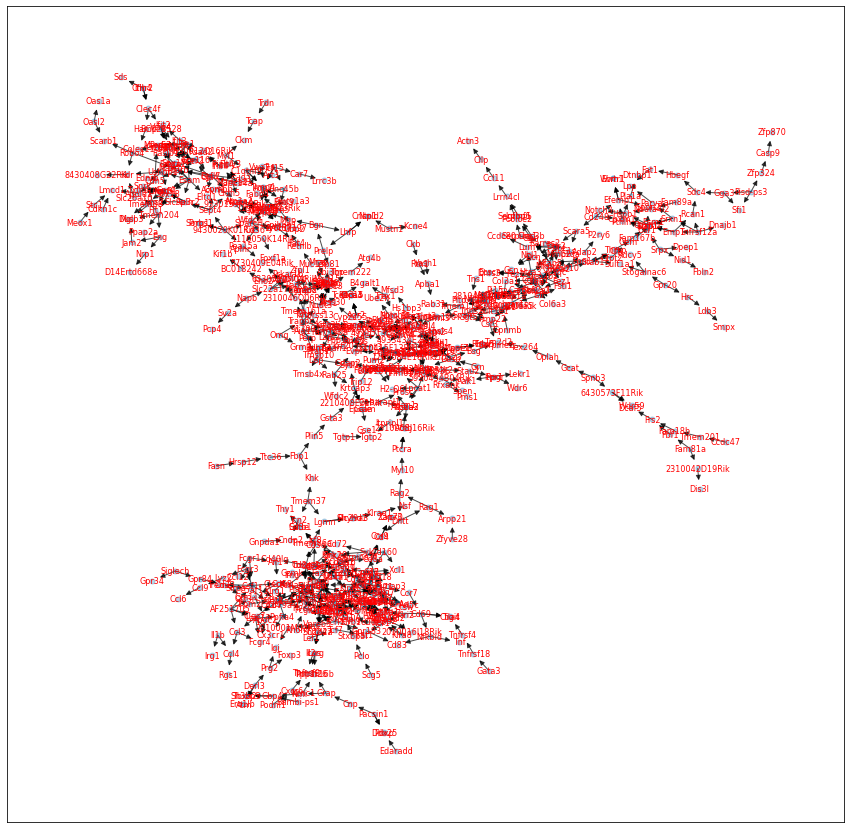

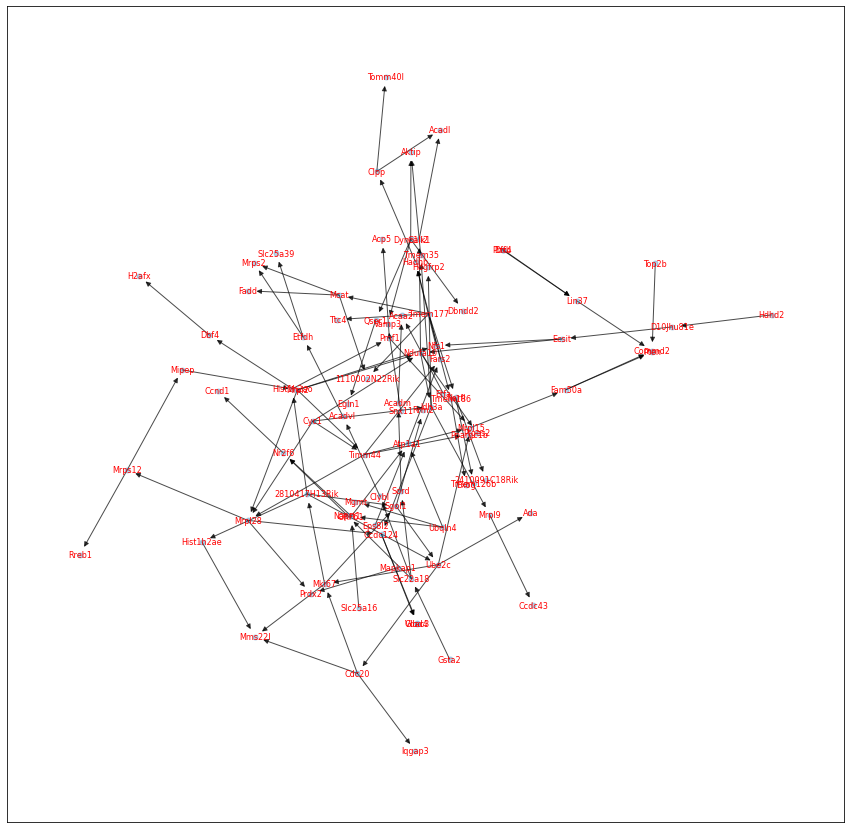

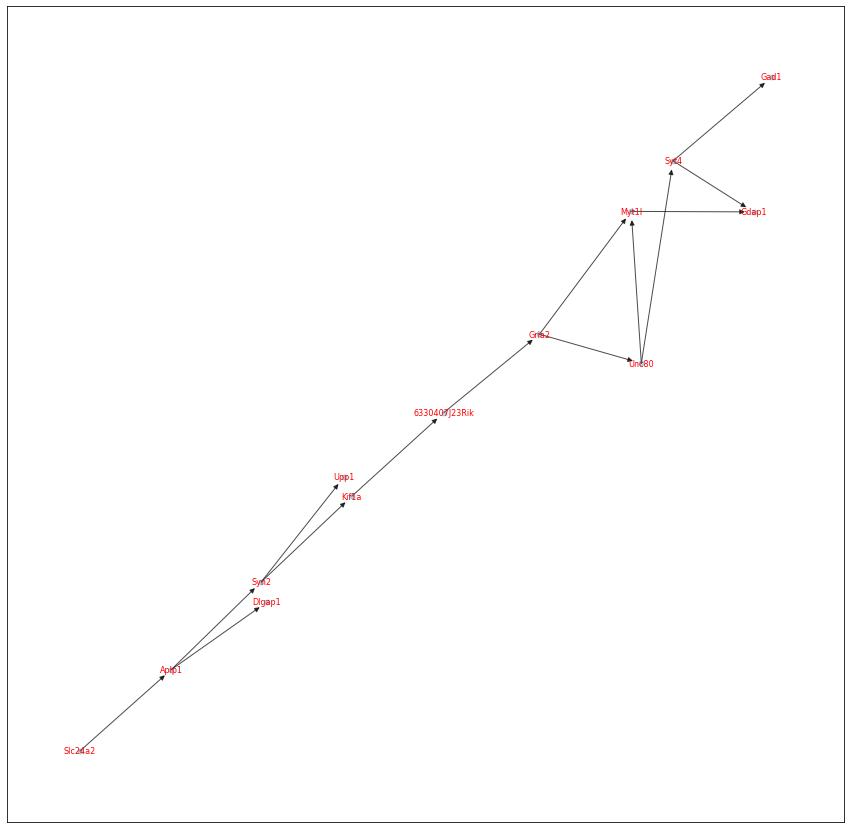

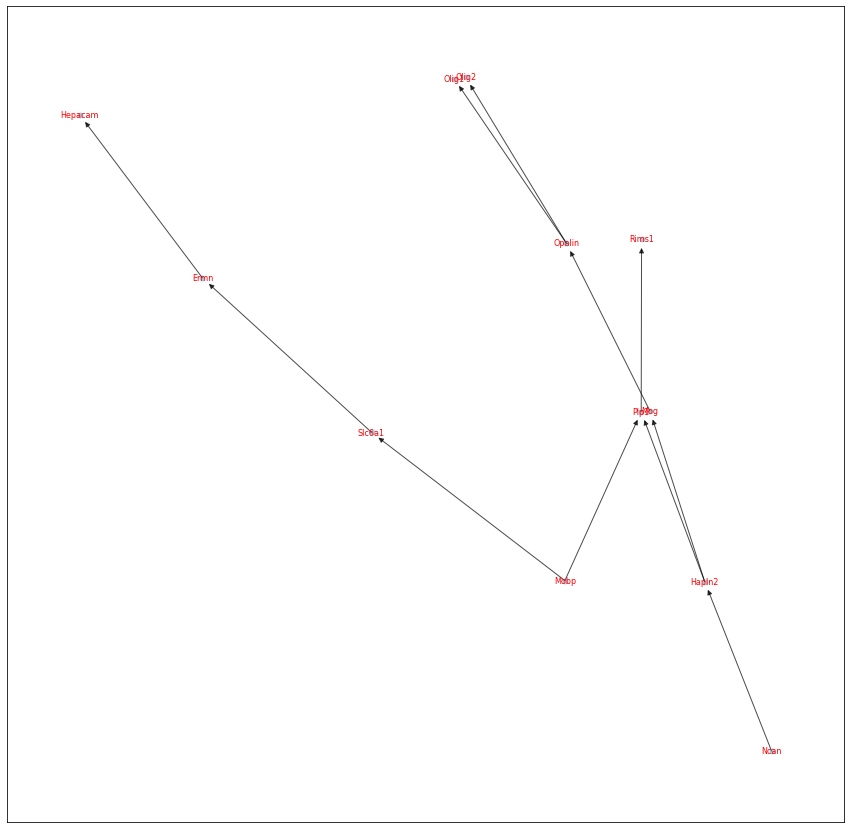

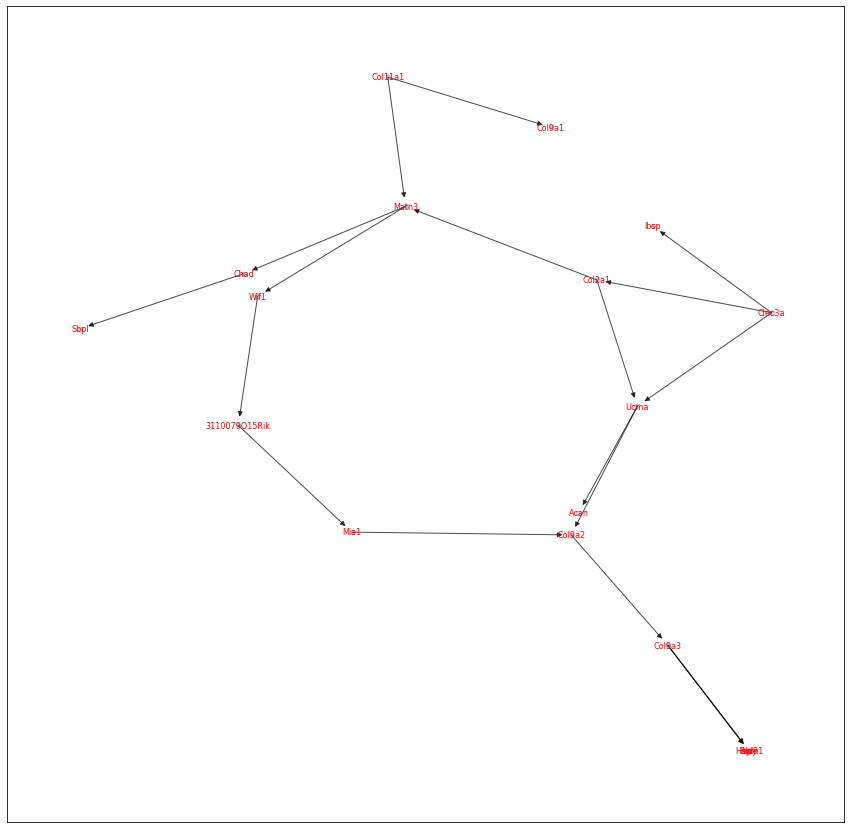

...

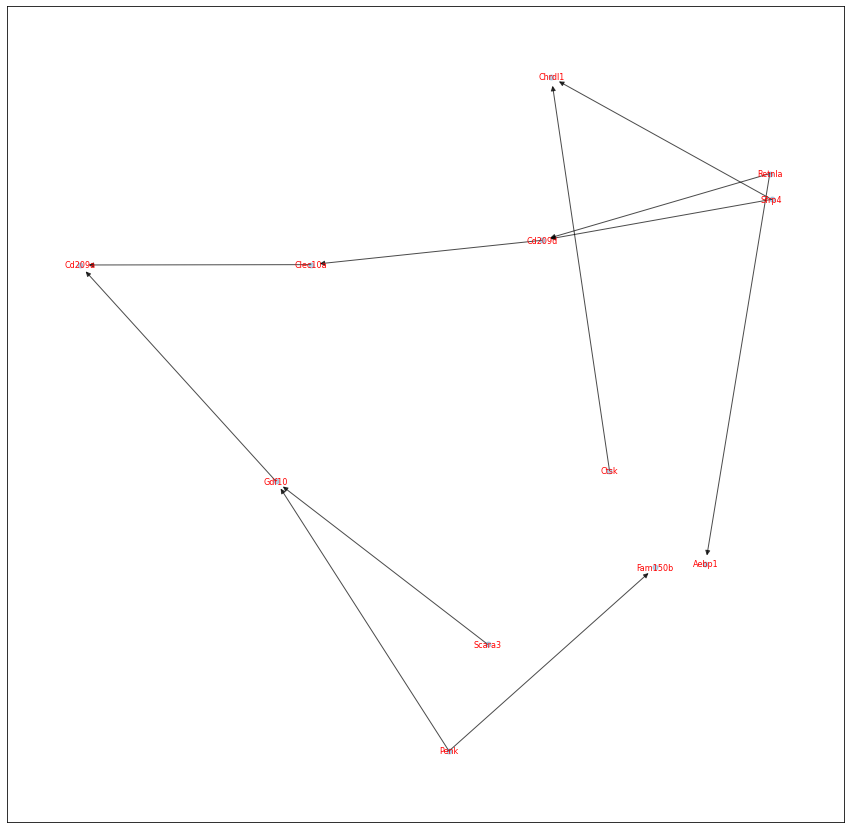

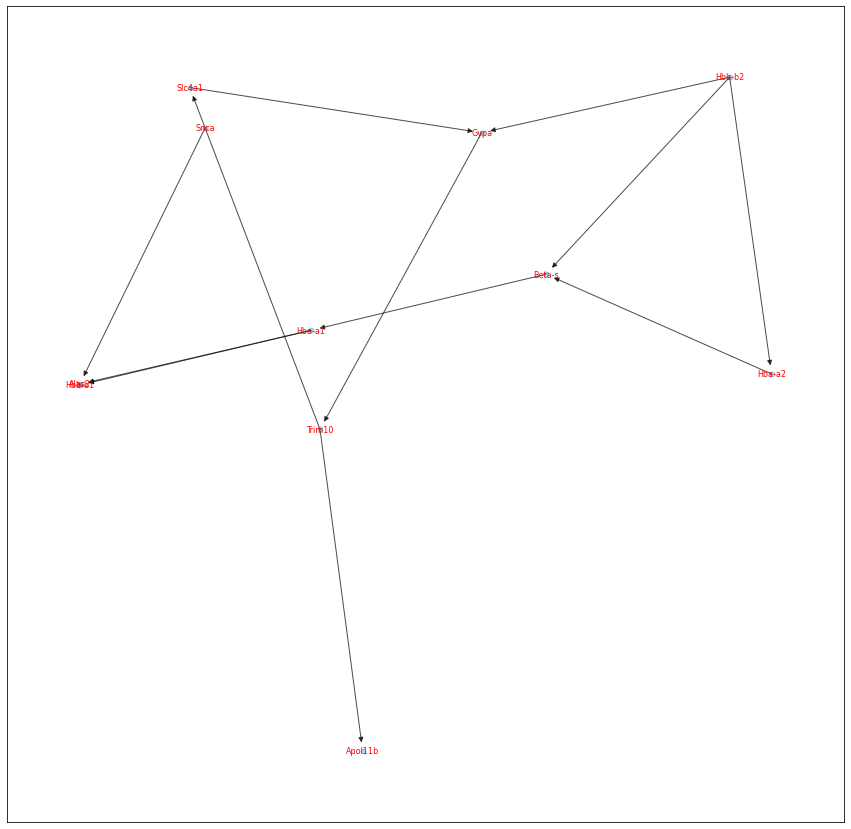

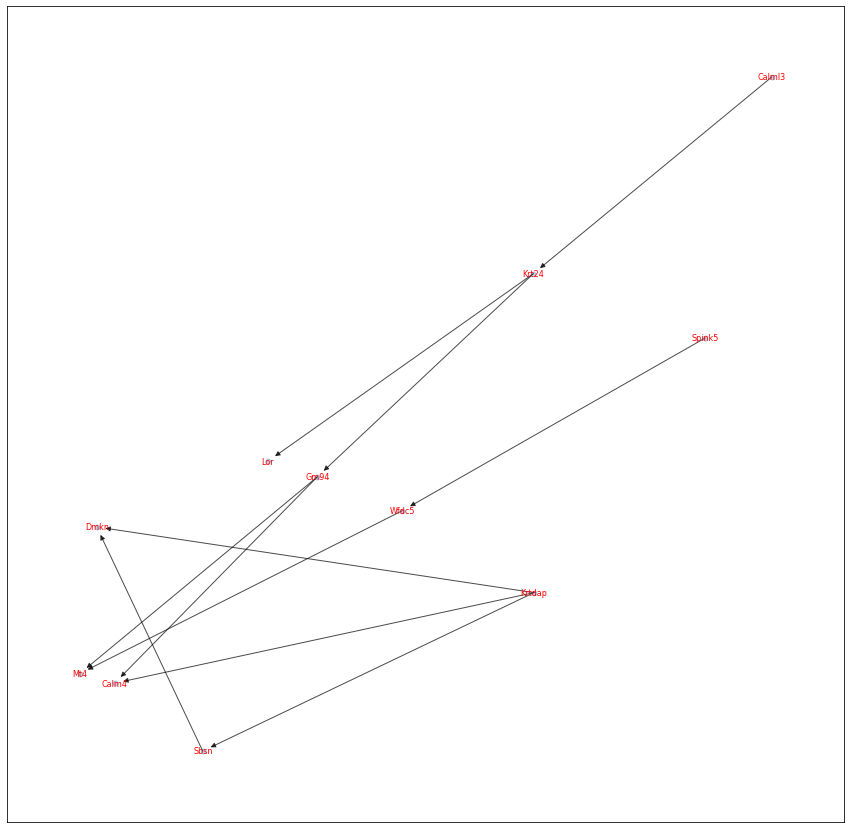

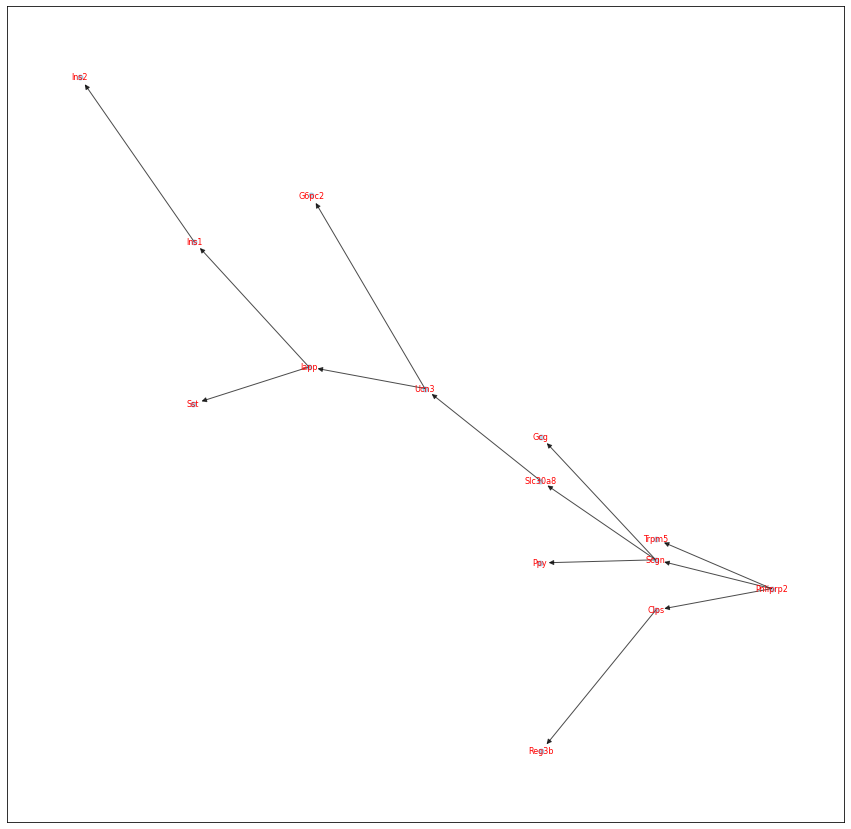

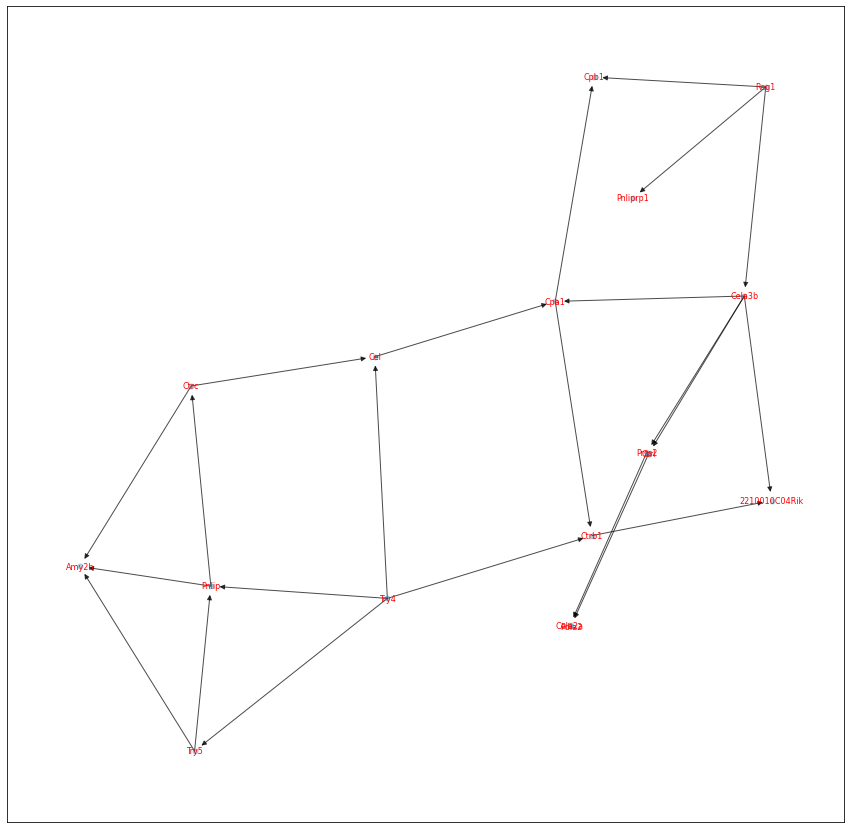

In [14]:
for S in target_G_list:
    pos=nx.kamada_kawai_layout(S)
    ## plot
    plt.figure(figsize=(15,15))
    nx.draw_networkx_nodes(S, pos, node_shape='.',node_size=100,alpha=0.3,)
    #nx.draw_networkx_edges(G, pos, edgelist=basal_edge_list,alpha=0.1, edge_cmap=plt.cm.Reds)
    #nx.draw_networkx_edges(G, pos, edgelist=decv_edge_list,alpha=0.3, edge_color="r",edge_cmap=plt.cm.Reds)
    nx.draw_networkx_edges(S, pos,alpha=0.7, edge_cmap=plt.cm.Reds)
    nx.draw_networkx_labels(S, pos,font_size=8, font_color="r")
    plt.show()


In [13]:
gg_set=set()
for gg in nx.connected_components(G):
    if len(gg)>5:
        gg_set=gg_set.union(gg)
        
Gd_s = Gd.subgraph(gg_set).copy()


NameError: name 'nx' is not defined

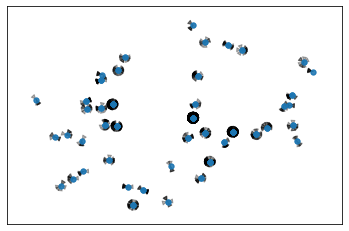

In [20]:
pos=nx.kamada_kawai_layout(Gd_s)
nx.draw_networkx_nodes(Gd_s, pos, node_shape='.',node_size=100,alpha=0.3)
#nx.draw_networkx_edges(G, pos, edgelist=basal_edge_list,alpha=0.1, edge_cmap=plt.cm.Reds)
#nx.draw_networkx_edges(G, pos, edgelist=decv_edge_list,alpha=0.3, edge_color="r",edge_cmap=plt.cm.Reds)
nx.draw_networkx_edges(Gd_s, pos, alpha=0.3, edge_cmap=plt.cm.Reds)
#nx.draw_networkx_labels(G, pos,font_size=8, font_color="r")
#plt.savefig(filename)
plt.show()


In [2]:
import numpy as np
import pandas as pd

df_ecv=pd.read_csv("ecv_all3/all.txt",sep="\t")
df_ecv

,Parent,Child,id,parent.id,child.id,edgeScore,BS.Prob,BS.Direction,bspline,gain,...,parent.type,child.type,parent.hubness,child.hubness,parent.BS.HubIndex,child.BS.HubIndex,parent.mean,child.mean,parent.variance,child.variance
0,Tie1,Sox17,1,1563,1,0.097,0.097,0.783505,0.0008057:1.1624292:-0.0208376:0.0139739:0.057...,55.194766,...,real,real,14,5,2.432,0.708,0.002259,0.000997,0.001651,0.001039
1,Rasip1,Sox17,2,2045,1,0.114,0.114,0.570175,0.0079438:1.0478846:-0.0323561:-0.0038756:0.02...,41.158515,...,real,real,8,5,0.849,0.708,0.010341,0.000997,0.004411,0.001039
2,Esam,Sox17,3,2329,1,0.536,0.536,0.936567,0.0065743:1.5823585:-0.0180397:0.0017182:0.041...,43.815886,...,real,real,16,5,2.838,0.708,0.000671,0.000997,0.002392,0.001039
3,Ube2c,Mrpl15,4,1323,2,0.229,0.229,0.886463,0.0104265:0.9490240:0.1066300:0.2234706:0.3351...,16.788183,...,real,real,9,8,1.799,0.903,0.000000,0.000000,0.000611,0.002255
4,Pmf1,Mrpl15,5,1393,2,0.322,0.322,0.881988,0.0745607:0.9769841:0.1878400:0.2374250:0.2812...,19.302089,...,real,real,5,8,0.928,0.903,0.000000,0.000000,0.002168,0.002255
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12071,Jmjd8,Tmsb4x,12072,928,2488,0.053,0.053,0.943396,0.1519452:0.7185136:1.2109350:1.1300381:1.0491...,12.291677,...,real,real,8,2,0.960,0.334,0.000000,0.000000,0.001419,0.020599
12072,Zfp523,Tmsb4x,12073,935,2488,0.106,0.106,0.962264,0.0920120:0.6417622:1.7267691:1.6484926:1.5698...,10.453787,...,real,real,15,2,1.351,0.334,0.000221,0.000000,0.000787,0.020599
12073,Notch2,Tmsb4x,12074,1436,2488,0.097,0.097,0.958763,0.0794185:1.1079149:0.6170079:0.7863205:0.9512...,10.900811,...,real,real,2,2,0.748,0.334,0.000000,0.000000,0.005672,0.020599
12074,Uox,Tmsb4x,12075,1487,2488,0.054,0.054,0.814815,0.0004973:2.0619171:4.8456120:1.6401681:-1.234...,13.763947,...,real,real,2,2,0.582,0.334,0.000162,0.000000,0.000502,0.020599


In [3]:
ecv_list=[]
for e in df_ecv.columns:
    if "ECv" in e:
        print(e)
        ecv_list.append(e)

ECv:Liver.txt_sLiver.txt
ECv:Diaphragm.txt_sDiaphragm.txt
ECv:Thymus.txt_sThymus.txt
ECv:Fat.txt_sFat.txt
ECv:Heart.txt_sHeart.txt
ECv:BAT.txt_sBAT.txt
ECv:Skin.txt_sSkin.txt
ECv:Brain_Non-Myeloid.txt_sBrain_Non-Myeloid.txt
ECv:Pancreas.txt_sPancreas.txt
ECv:Aorta.txt_sAorta.txt
ECv:Large_Intestine.txt_sLarge_Intestine.txt
ECv:GAT.txt_sGAT.txt
ECv:Bladder.txt_sBladder.txt
ECv:Trachea.txt_sTrachea.txt
ECv:Kidney.txt_sKidney.txt
ECv:MAT.txt_sMAT.txt
ECv:Tongue.txt_sTongue.txt
ECv:SCAT.txt_sSCAT.txt
ECv:Brain_Myeloid.txt_sBrain_Myeloid.txt
ECv:Mammary_Gland.txt_sMammary_Gland.txt
ECv:Lung.txt_sLung.txt
ECv:Limb_Muscle.txt_sLimb_Muscle.txt
ECv:Spleen.txt_sSpleen.txt
ECv:Marrow.txt_sMarrow.txt


In [4]:
df_ecv[['Parent', 'Child','ECv:Liver.txt_sLiver.txt']]

,Parent,Child,ECv:Liver.txt_sLiver.txt
0,Tie1,Sox17,0.205056
1,Rasip1,Sox17,0.188226
2,Esam,Sox17,0.179140
3,Ube2c,Mrpl15,0.332079
4,Pmf1,Mrpl15,0.624449
...,...,...,...
12071,Jmjd8,Tmsb4x,0.685438
12072,Zfp523,Tmsb4x,1.369261
12073,Notch2,Tmsb4x,1.256434
12074,Uox,Tmsb4x,0.942922


(-2.0, 5.0)

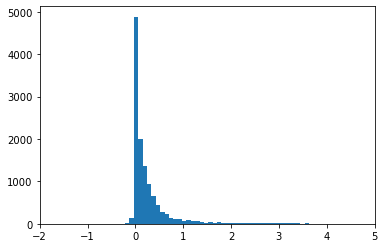

In [6]:
import matplotlib.pyplot as plt
plt.hist(df_ecv['ECv:Liver.txt_sLiver.txt'],bins=100)
plt.xlim(-2,5)

(-2.0, 2.0)

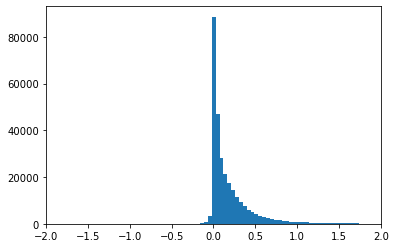

In [7]:
x=np.ravel(df_ecv[ecv_list].values)
plt.hist(x,bins=300)
plt.xlim(-2,2)

In [8]:
df_ecv[['Parent', 'Child','ECv:Liver.txt_sLiver.txt']]

,Parent,Child,ECv:Liver.txt_sLiver.txt
0,Tie1,Sox17,0.205056
1,Rasip1,Sox17,0.188226
2,Esam,Sox17,0.179140
3,Ube2c,Mrpl15,0.332079
4,Pmf1,Mrpl15,0.624449
...,...,...,...
12071,Jmjd8,Tmsb4x,0.685438
12072,Zfp523,Tmsb4x,1.369261
12073,Notch2,Tmsb4x,1.256434
12074,Uox,Tmsb4x,0.942922


In [9]:
df2_ecv=df_ecv[['Parent', 'Child','ECv:Liver.txt_sLiver.txt']]
df2_ecv=df2_ecv[df2_ecv['ECv:Liver.txt_sLiver.txt'].abs()>1.0]
df2_ecv

,Parent,Child,ECv:Liver.txt_sLiver.txt
36,Plin5,Gsta3,2.135336
37,Lrat,Gsta3,1.371268
39,Mmp13,Gsta3,2.140038
40,Ttc36,Gsta3,2.395391
100,Trpm2,Slc40a1,1.332423
...,...,...,...
12013,Ces1f,Cldn2,1.693946
12069,Sdr39u1,Tmsb4x,1.143986
12070,Oplah,Tmsb4x,1.035569
12072,Zfp523,Tmsb4x,1.369261


In [10]:
edge_ecv_list=[]
for i,e in df2_ecv.iterrows():
    edge_ecv_list.append((e['Parent'],e['Child']))
len(edge_ecv_list)

781

In [11]:
basal_g_list=[]
ecv_g_list=[]
for e in target_G_list[0].edges:
    if e in edge_ecv_list:
        ecv_g_list.append(e)
    else:
        basal_g_list.append(e)
        
len(ecv_g_list),len(basal_g_list)

NameError: name 'target_G_list' is not defined

In [12]:
ecv_list=[]
for e in df_ecv.columns:
    if "ECv" in e:
        print(e)
        ecv_list.append(e)

ECv:Liver.txt_sLiver.txt
ECv:Diaphragm.txt_sDiaphragm.txt
ECv:Thymus.txt_sThymus.txt
ECv:Fat.txt_sFat.txt
ECv:Heart.txt_sHeart.txt
ECv:BAT.txt_sBAT.txt
ECv:Skin.txt_sSkin.txt
ECv:Brain_Non-Myeloid.txt_sBrain_Non-Myeloid.txt
ECv:Pancreas.txt_sPancreas.txt
ECv:Aorta.txt_sAorta.txt
ECv:Large_Intestine.txt_sLarge_Intestine.txt
ECv:GAT.txt_sGAT.txt
ECv:Bladder.txt_sBladder.txt
ECv:Trachea.txt_sTrachea.txt
ECv:Kidney.txt_sKidney.txt
ECv:MAT.txt_sMAT.txt
ECv:Tongue.txt_sTongue.txt
ECv:SCAT.txt_sSCAT.txt
ECv:Brain_Myeloid.txt_sBrain_Myeloid.txt
ECv:Mammary_Gland.txt_sMammary_Gland.txt
ECv:Lung.txt_sLung.txt
ECv:Limb_Muscle.txt_sLimb_Muscle.txt
ECv:Spleen.txt_sSpleen.txt
ECv:Marrow.txt_sMarrow.txt


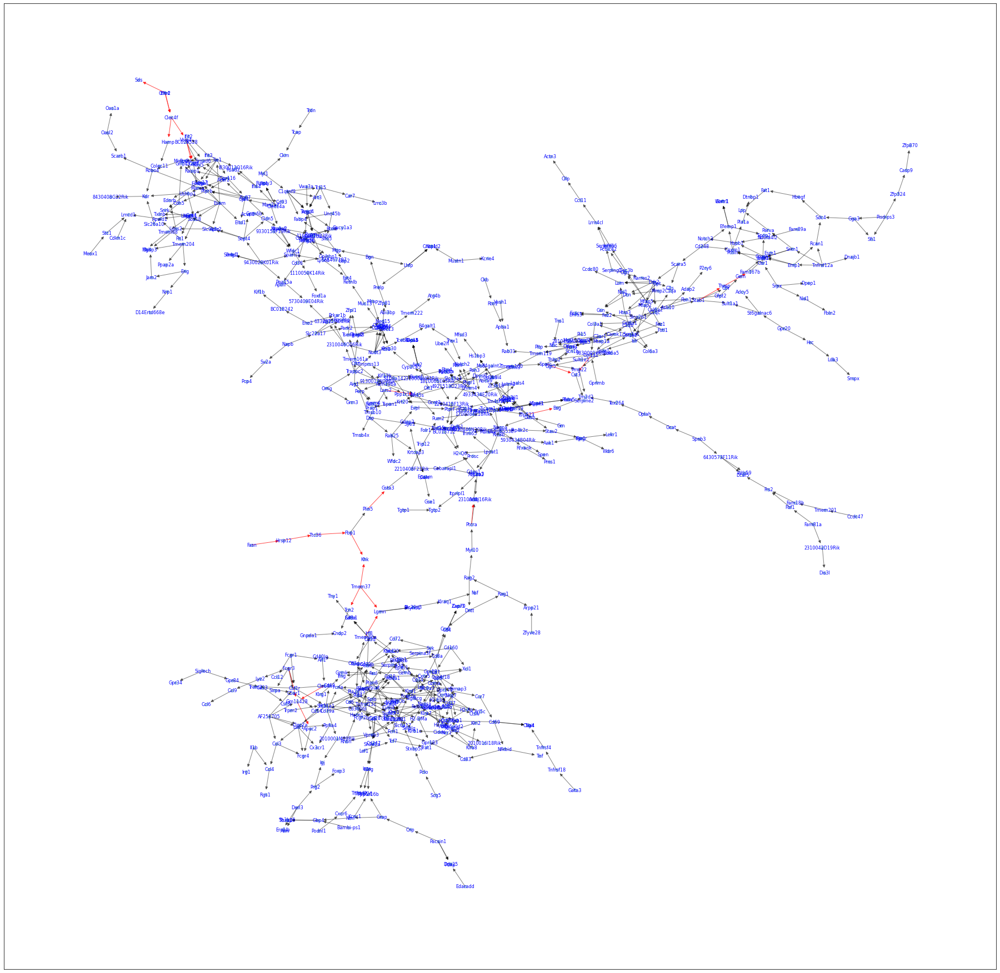

In [35]:
S=target_G_list[0]
pos=nx.kamada_kawai_layout(S)
## plot
plt.figure(figsize=(32,32))
nx.draw_networkx_nodes(S, pos, node_shape='.',node_size=100,alpha=0.3,)
#nx.draw_networkx_edges(G, pos, edgelist=basal_edge_list,alpha=0.1, edge_cmap=plt.cm.Reds)
nx.draw_networkx_edges(S, pos, edgelist=basal_g_list, alpha=0.5)
nx.draw_networkx_edges(S, pos, edgelist=ecv_g_list, alpha=0.7, edge_color="r",edge_cmap=plt.cm.Reds)
nx.draw_networkx_labels(S, pos,font_size=8, font_color="blue")
plt.show()

'Liver'

116 / 643


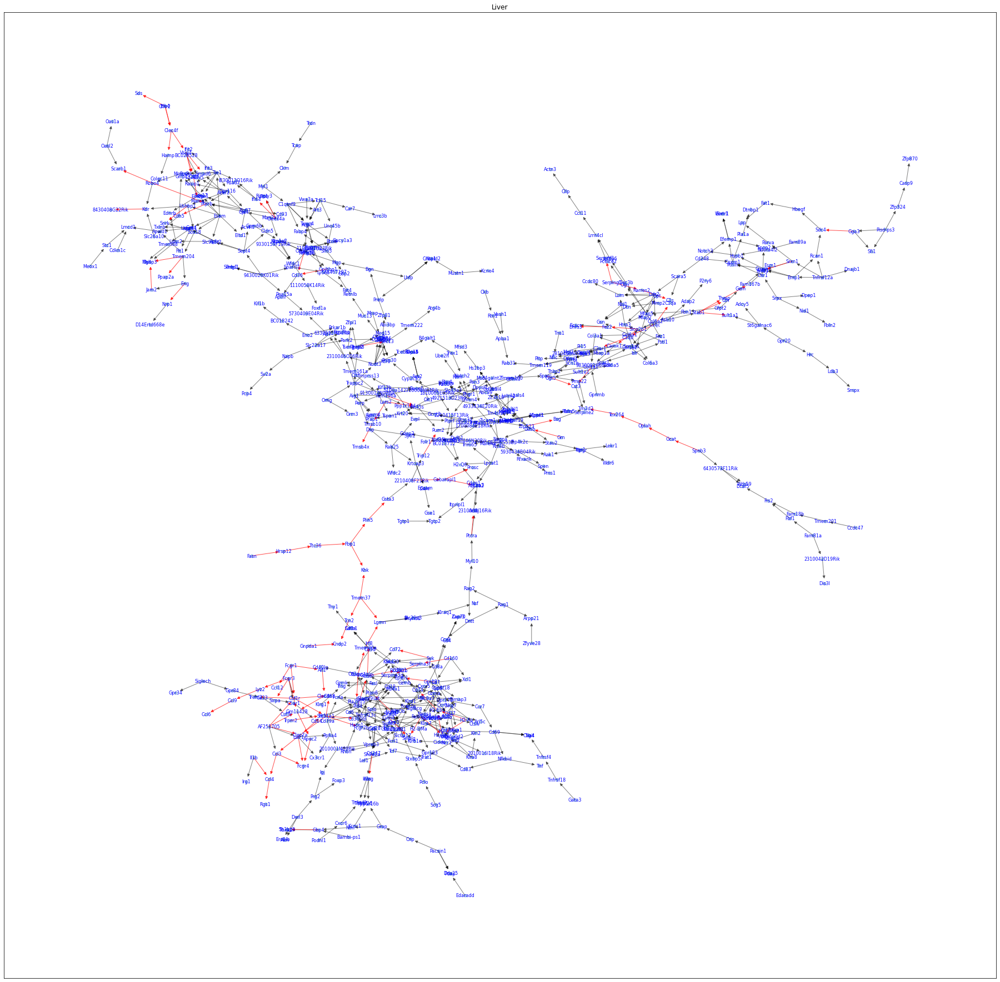

90 / 669


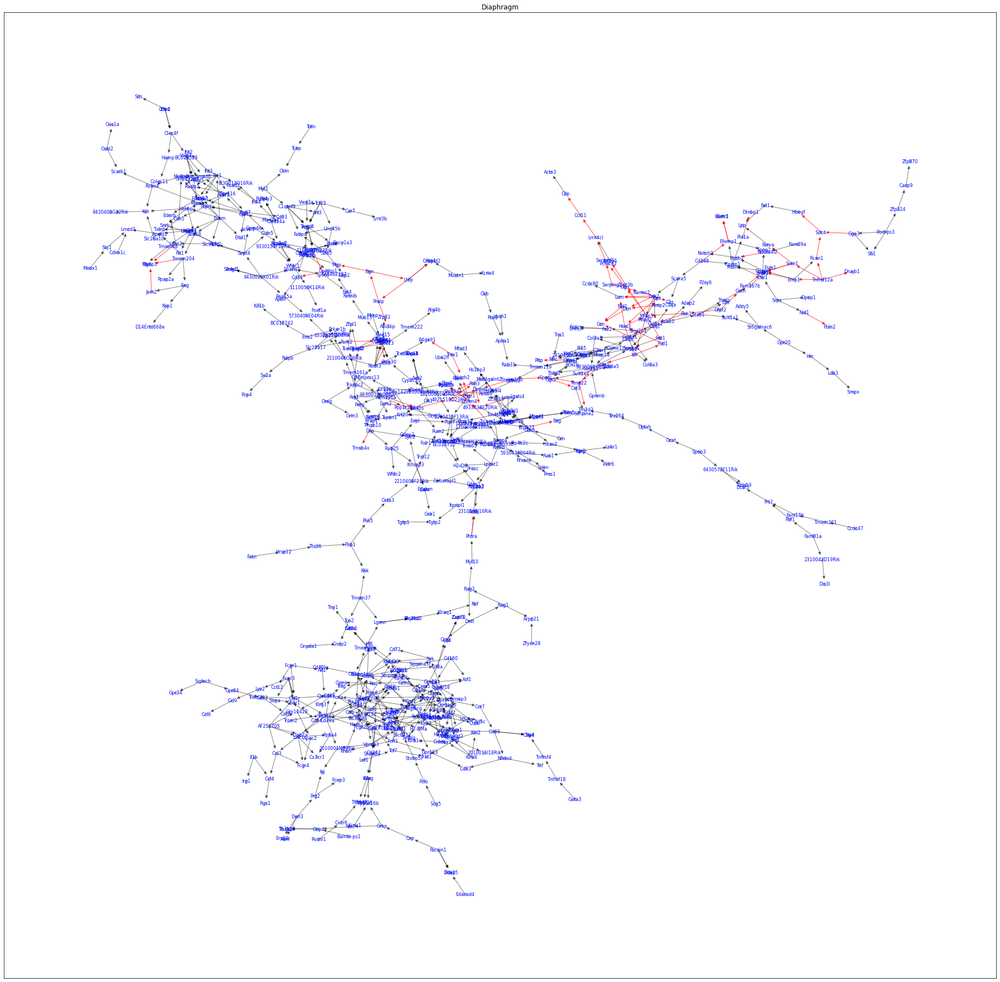

91 / 668


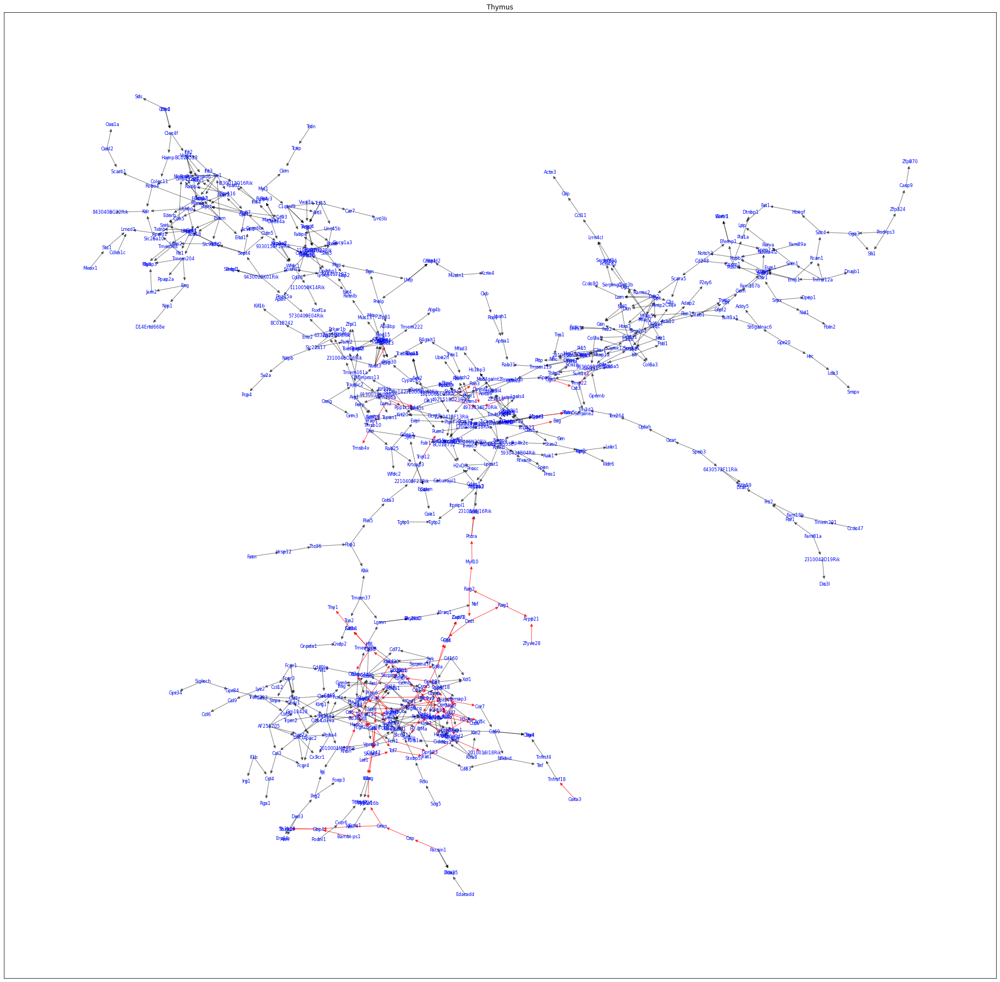

160 / 599


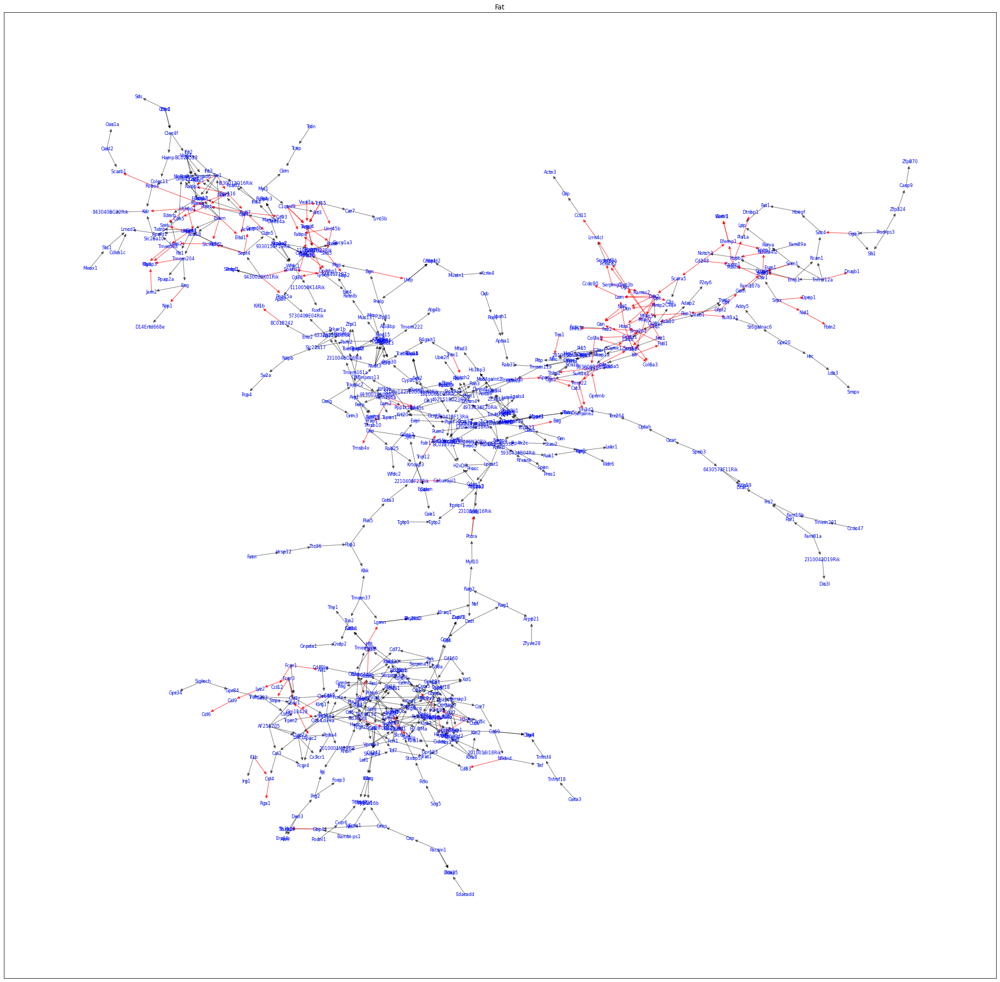

216 / 543


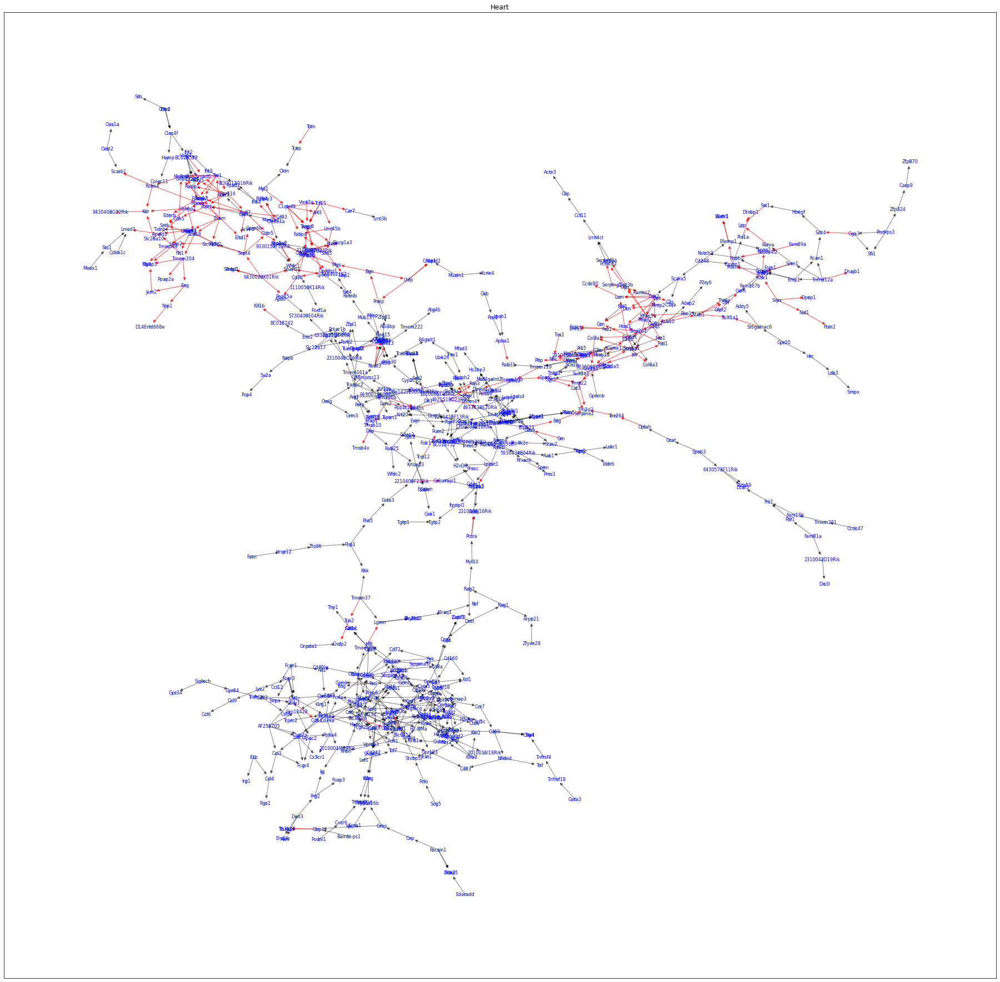

110 / 649


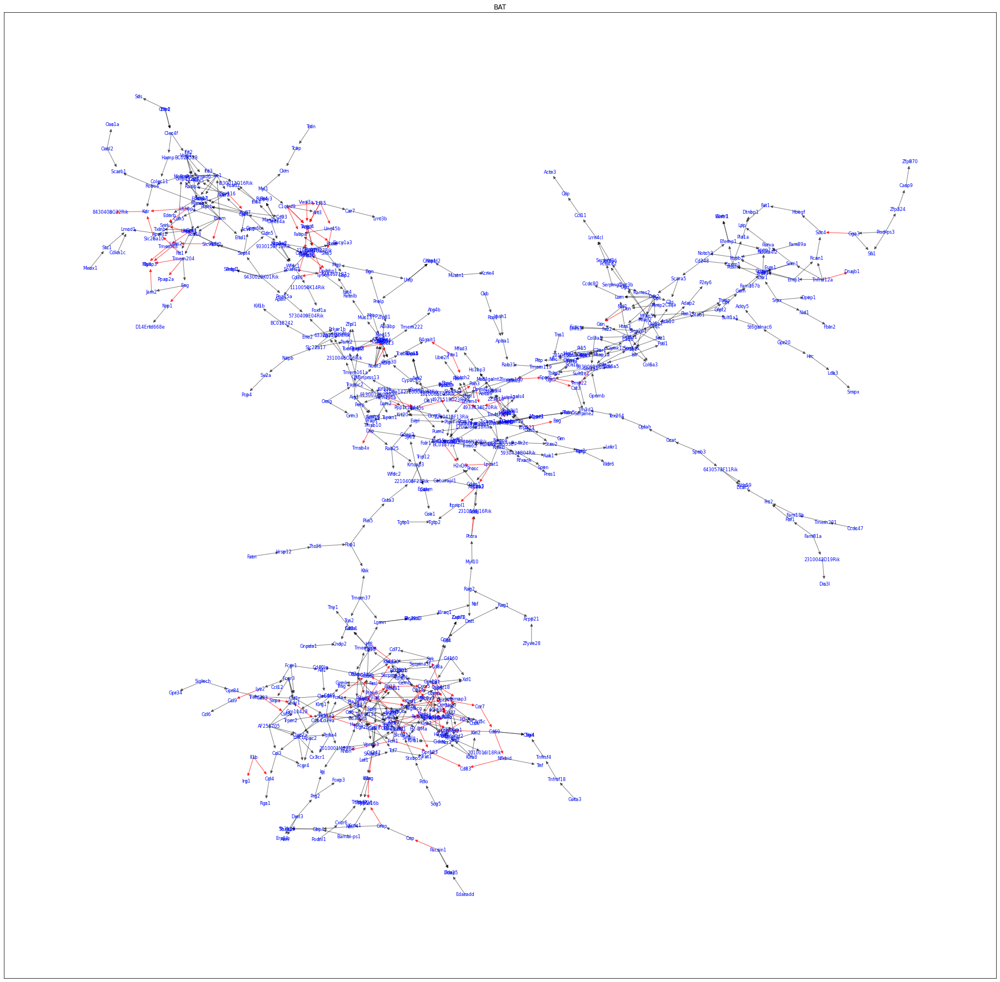

63 / 696


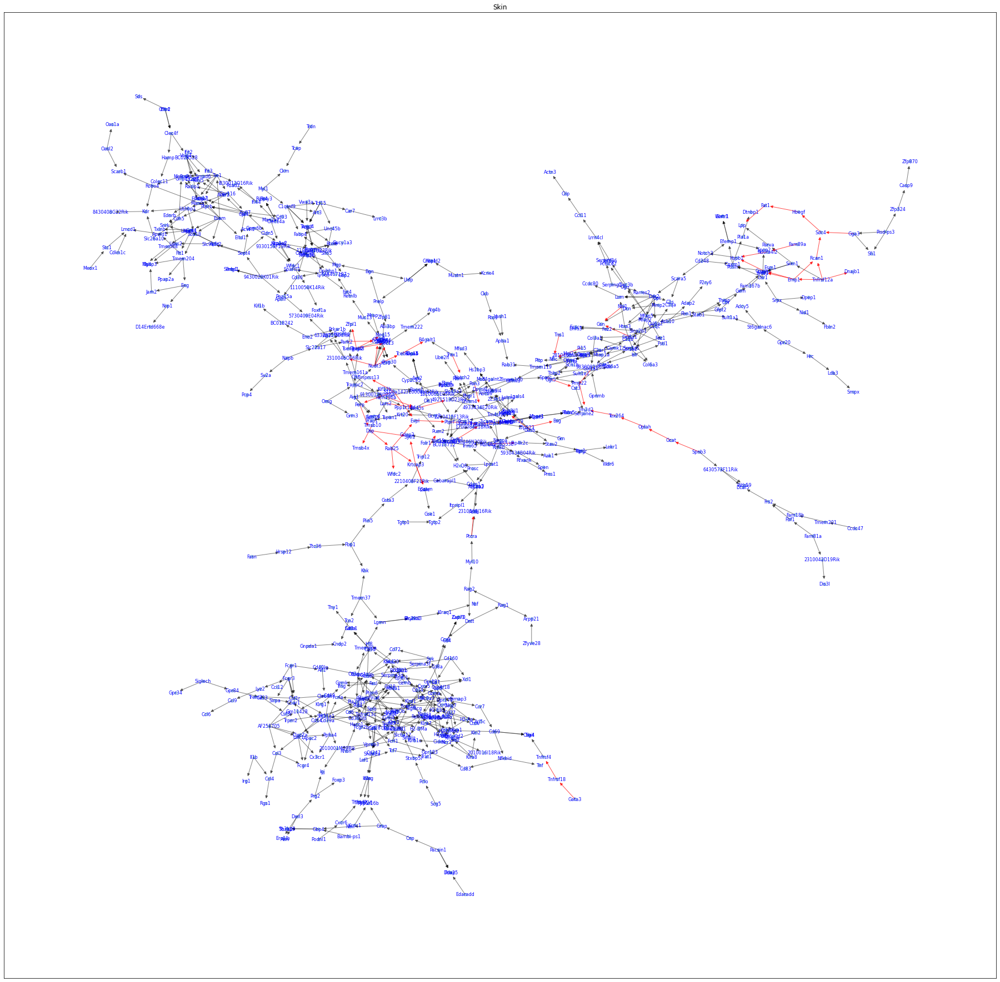

139 / 620


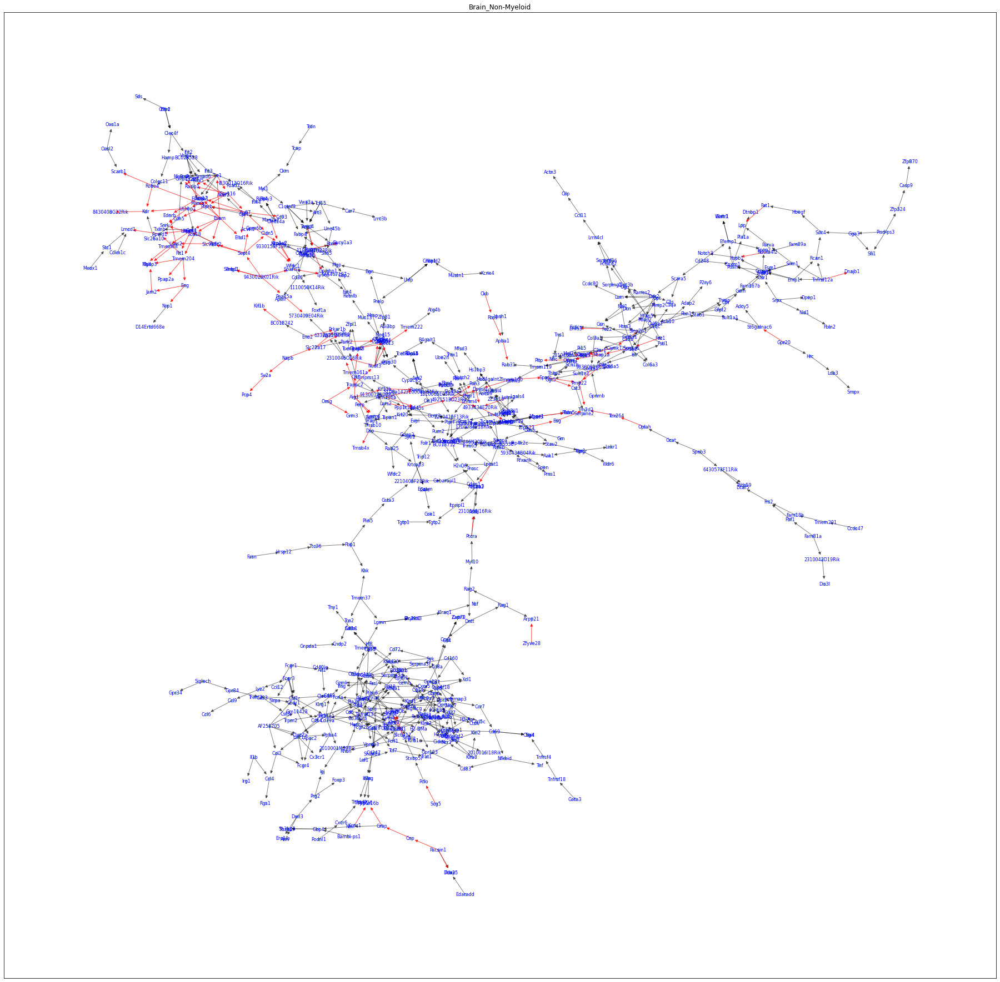

32 / 727


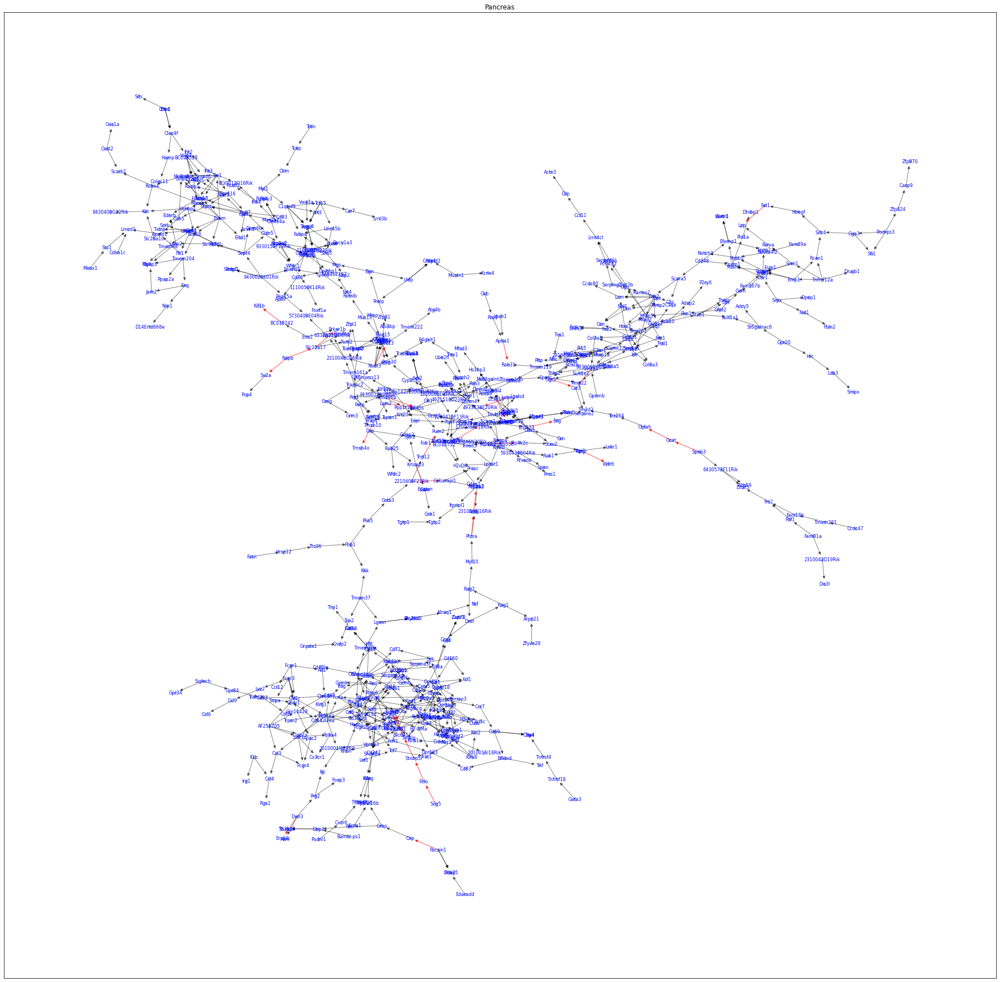

169 / 590


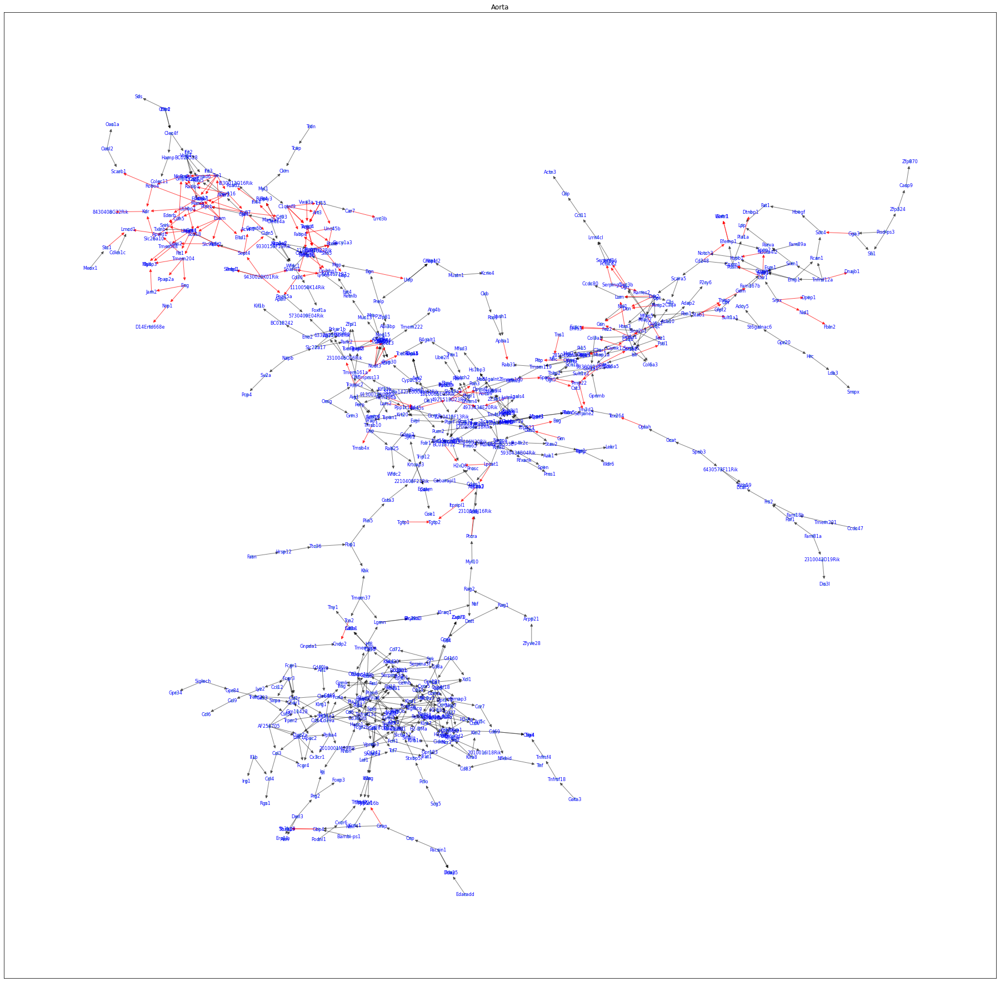

78 / 681


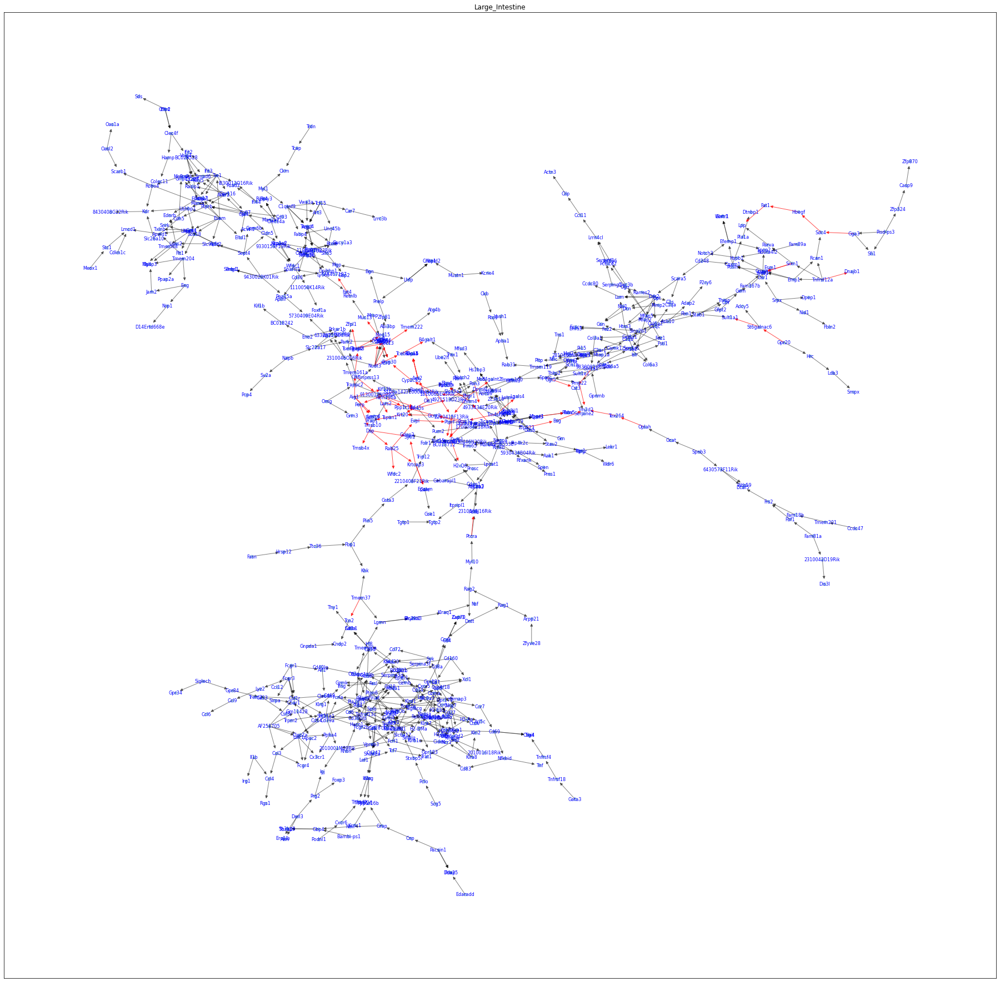

159 / 600


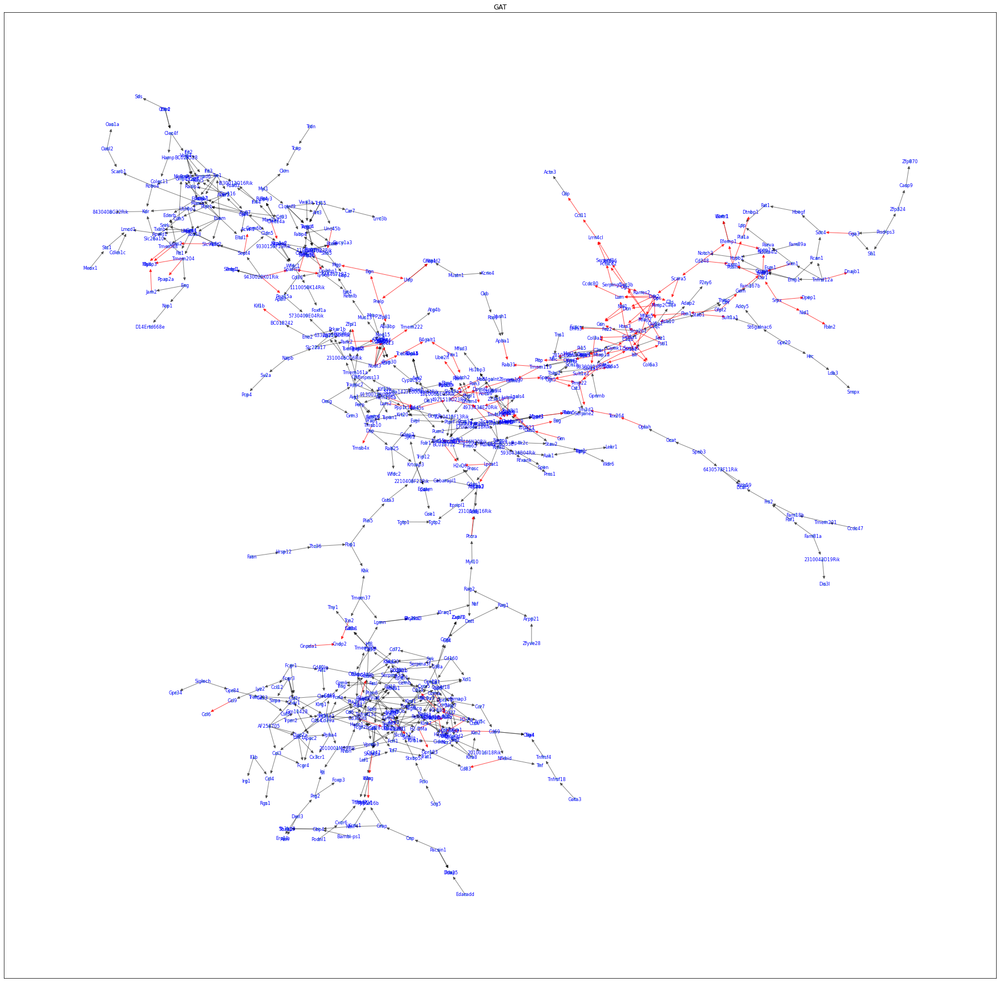

95 / 664


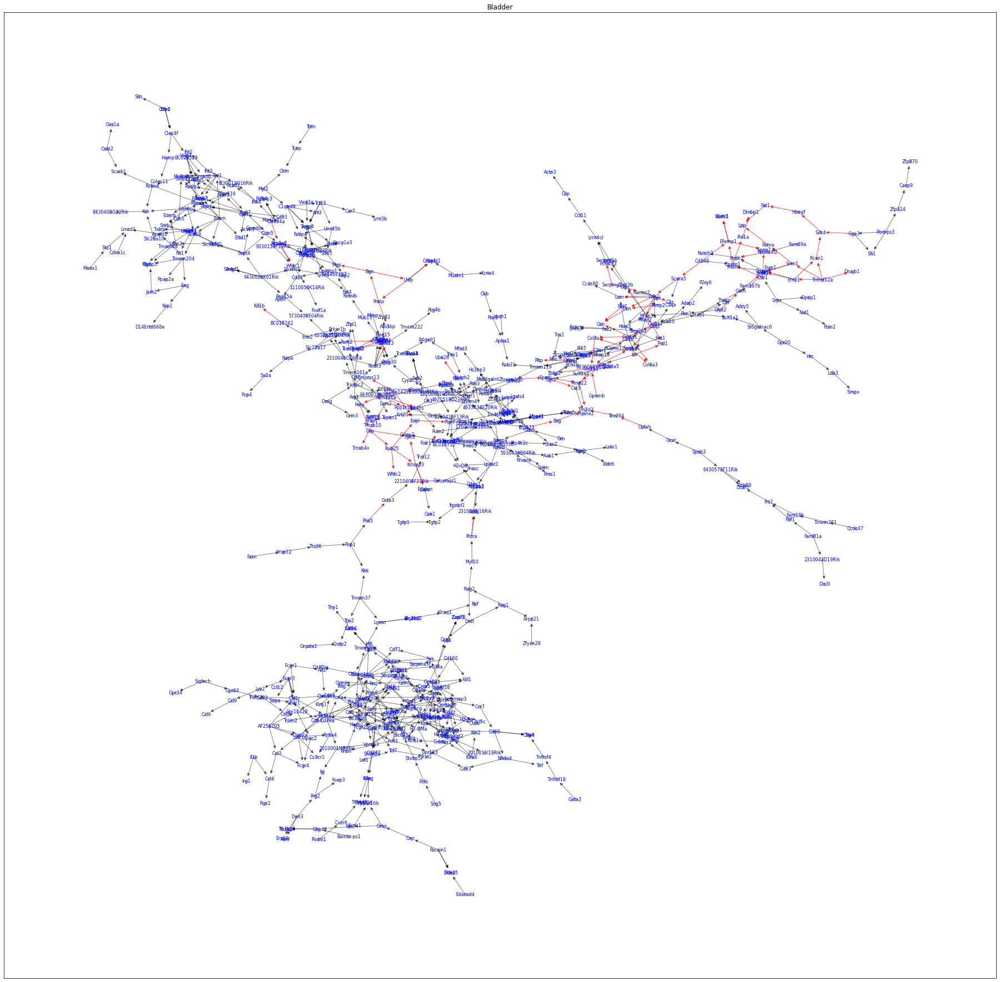

107 / 652


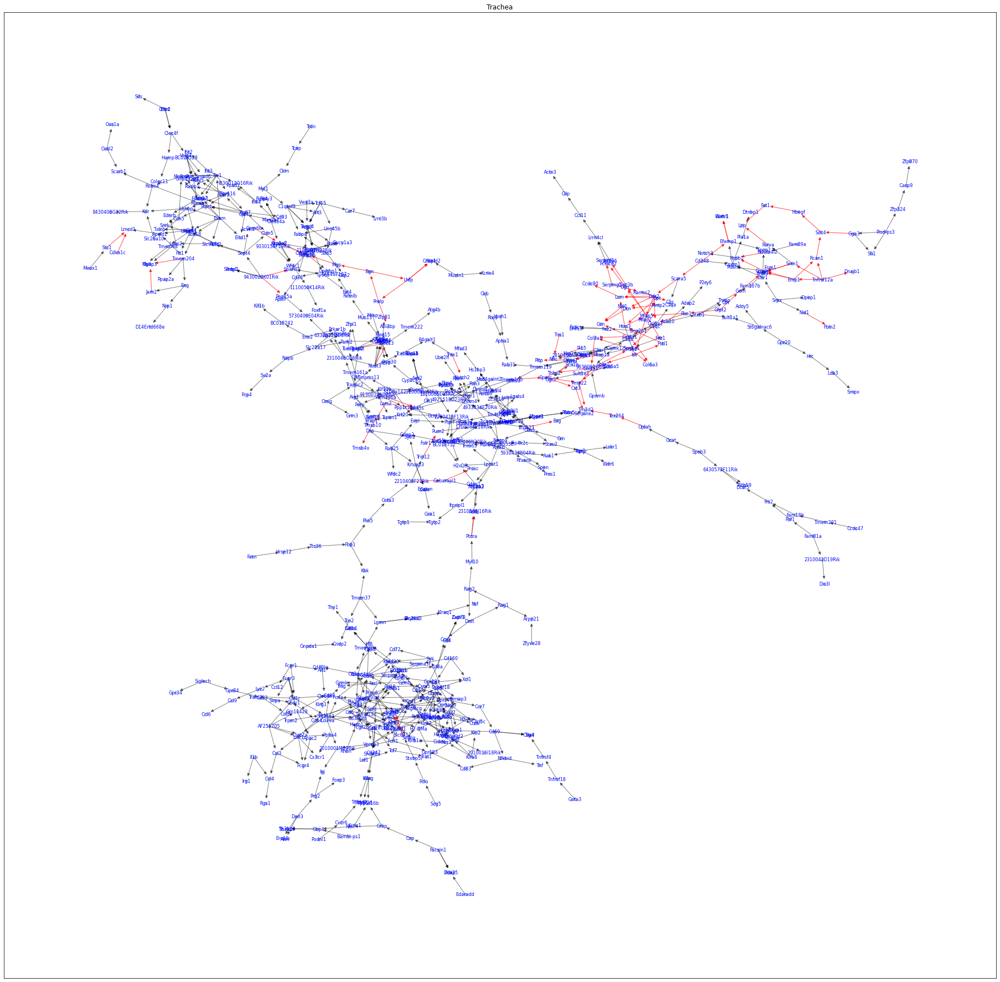

43 / 716


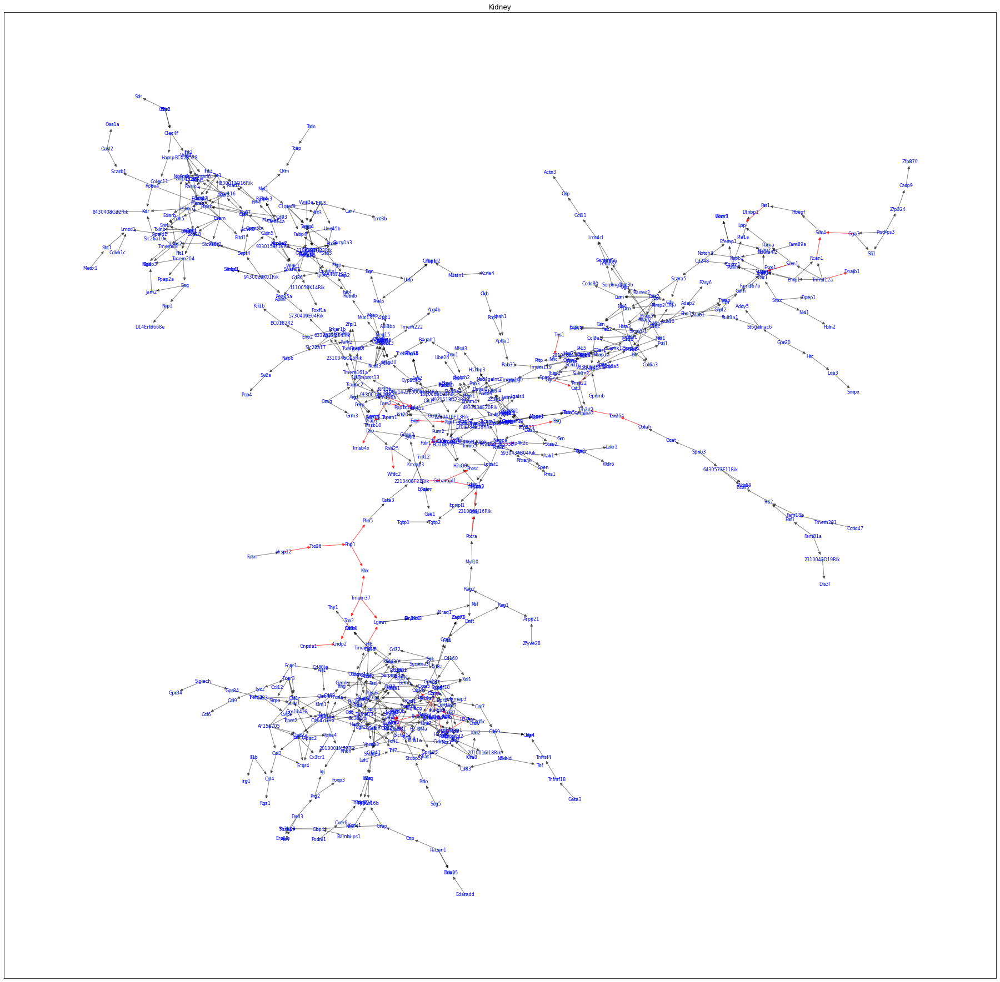

150 / 609


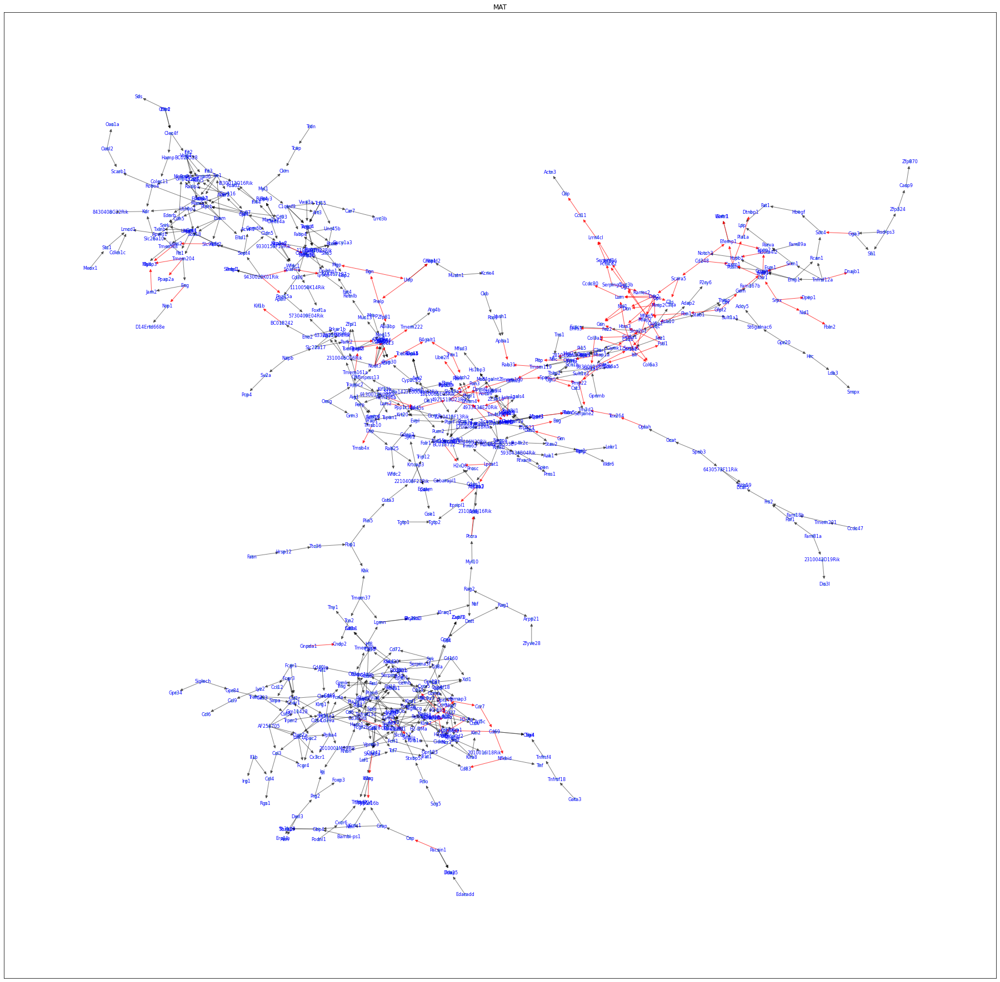

52 / 707


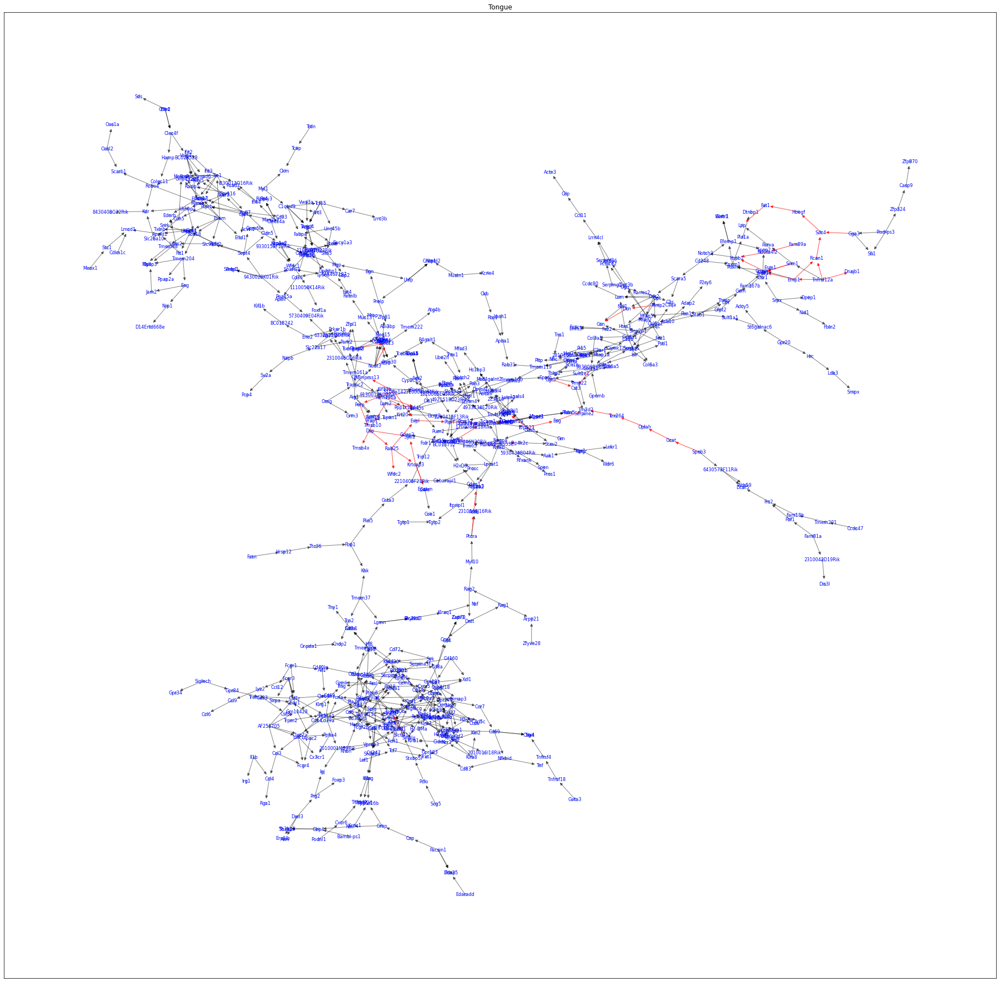

165 / 594


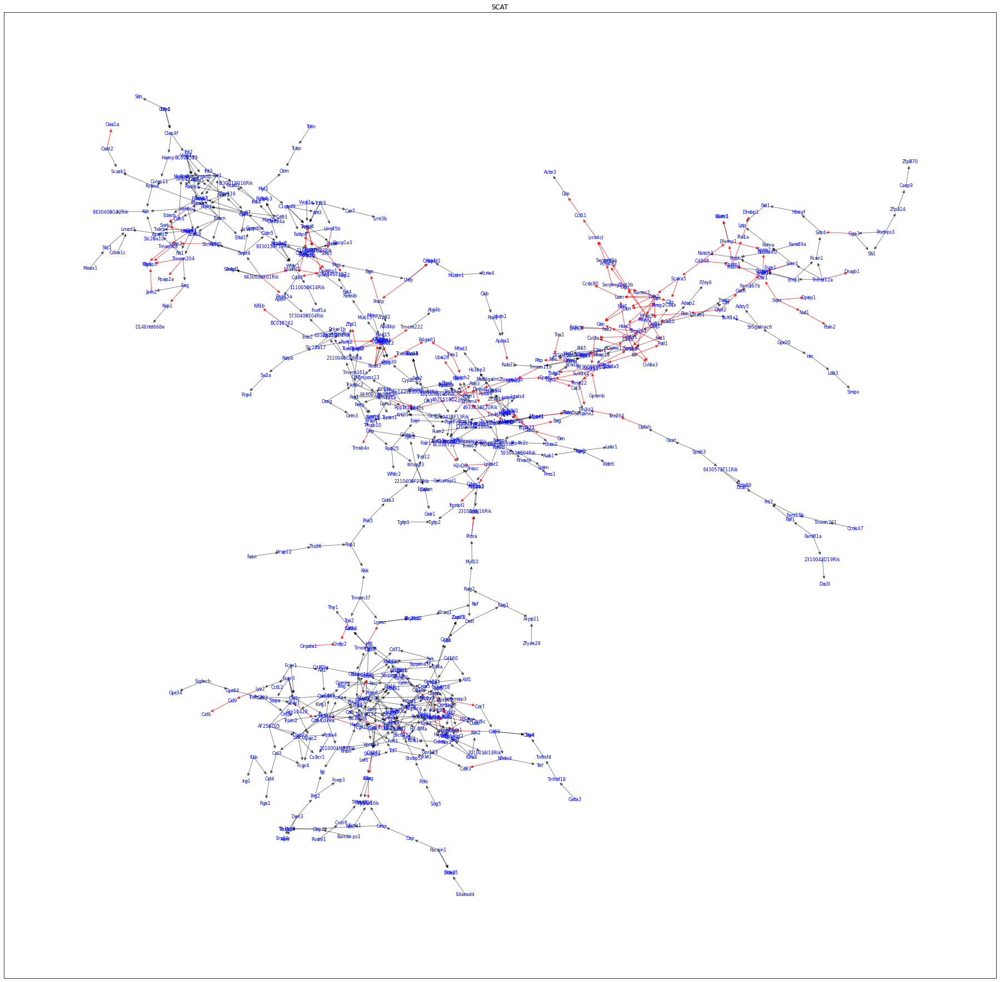

156 / 603


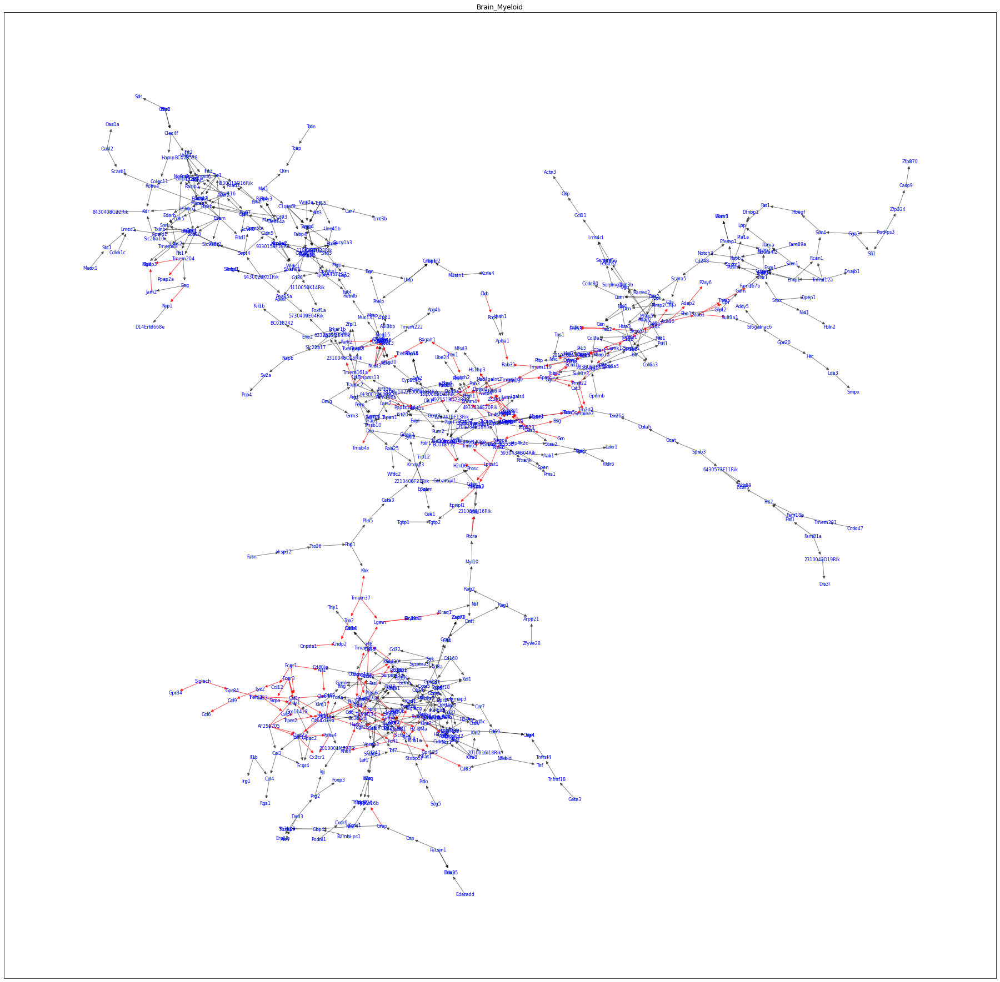

72 / 687


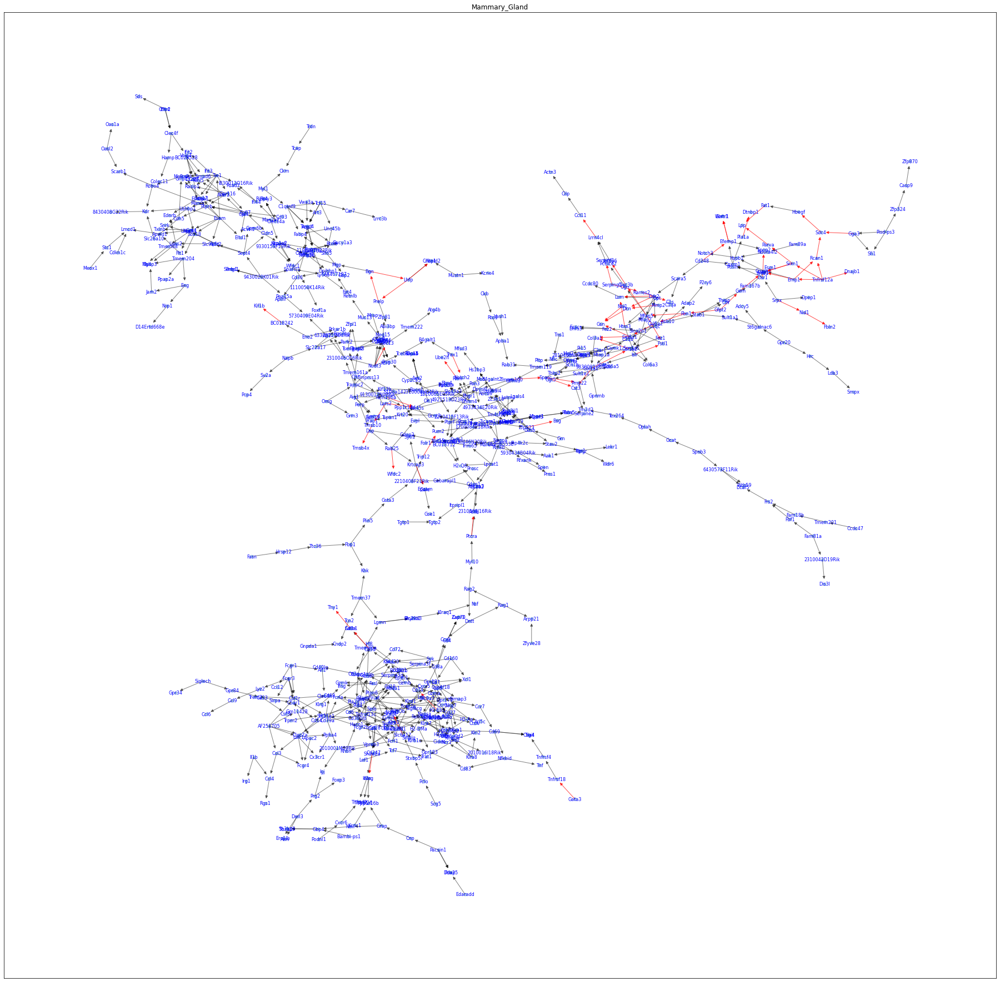

79 / 680


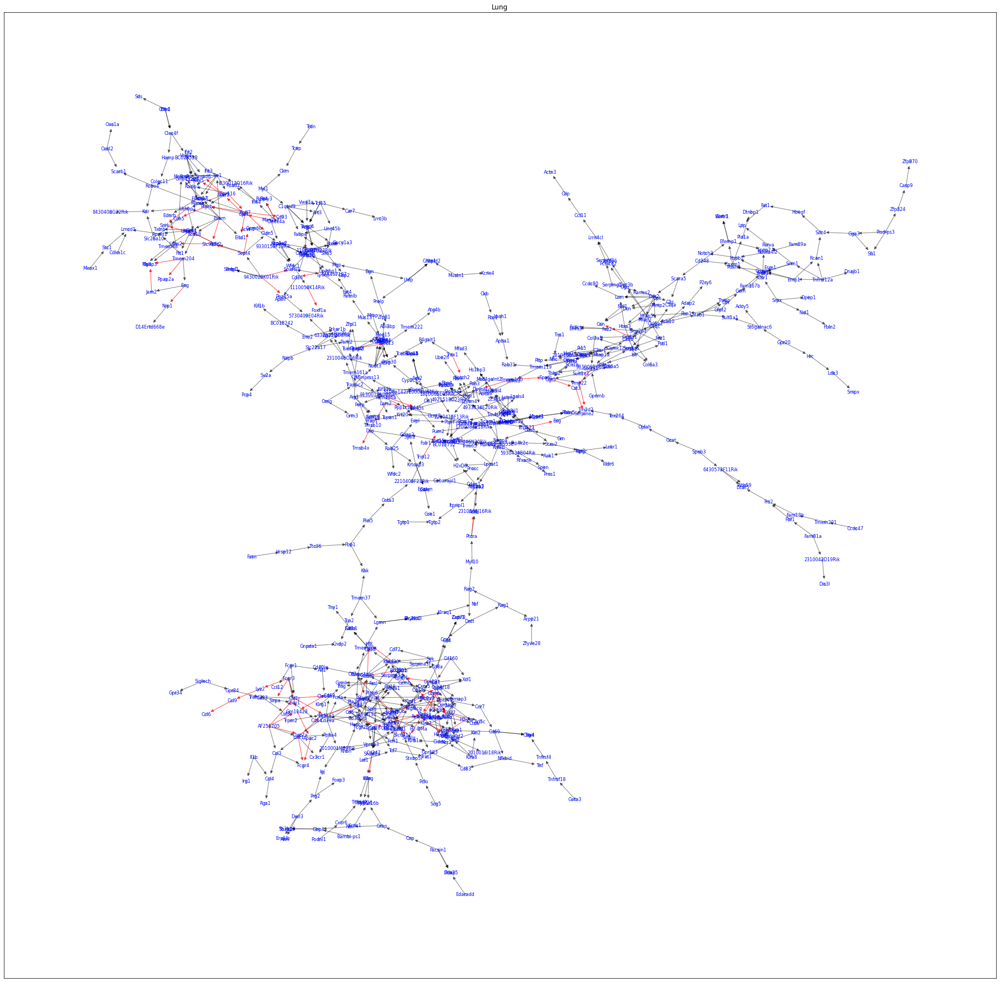

147 / 612


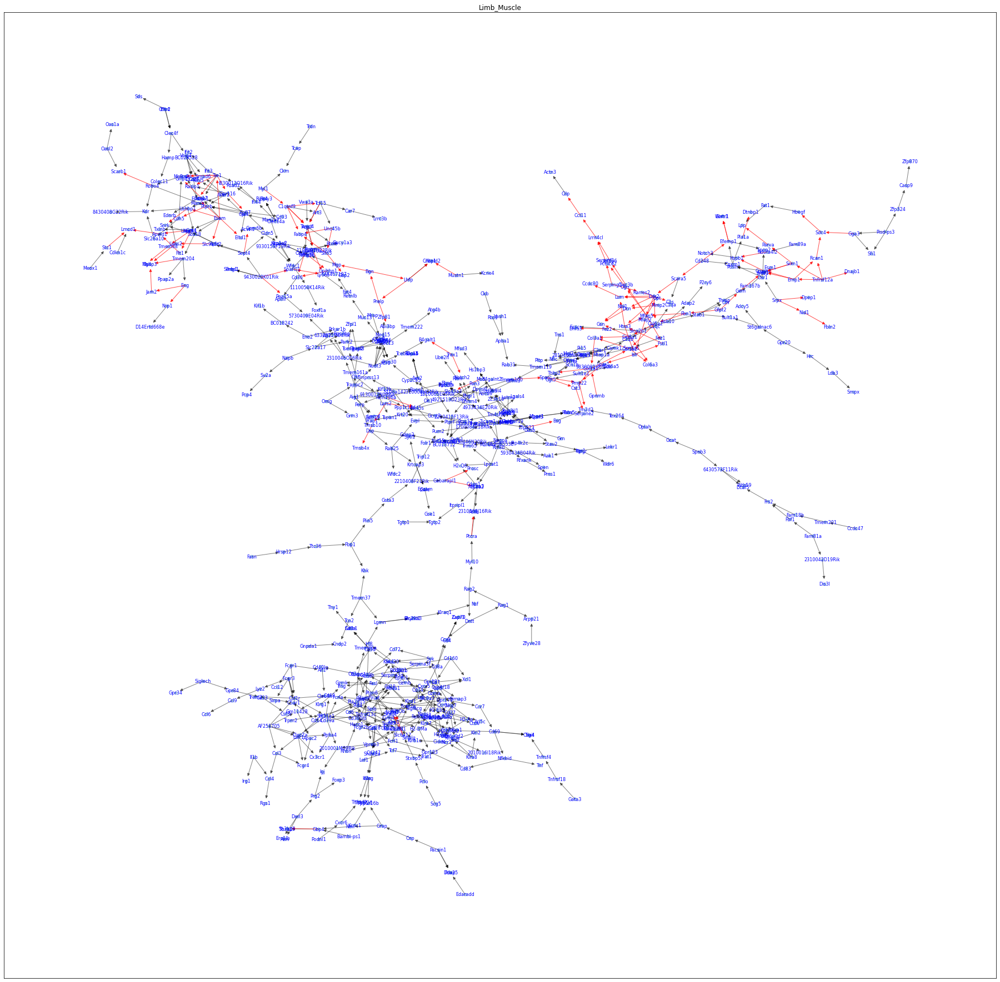

93 / 666


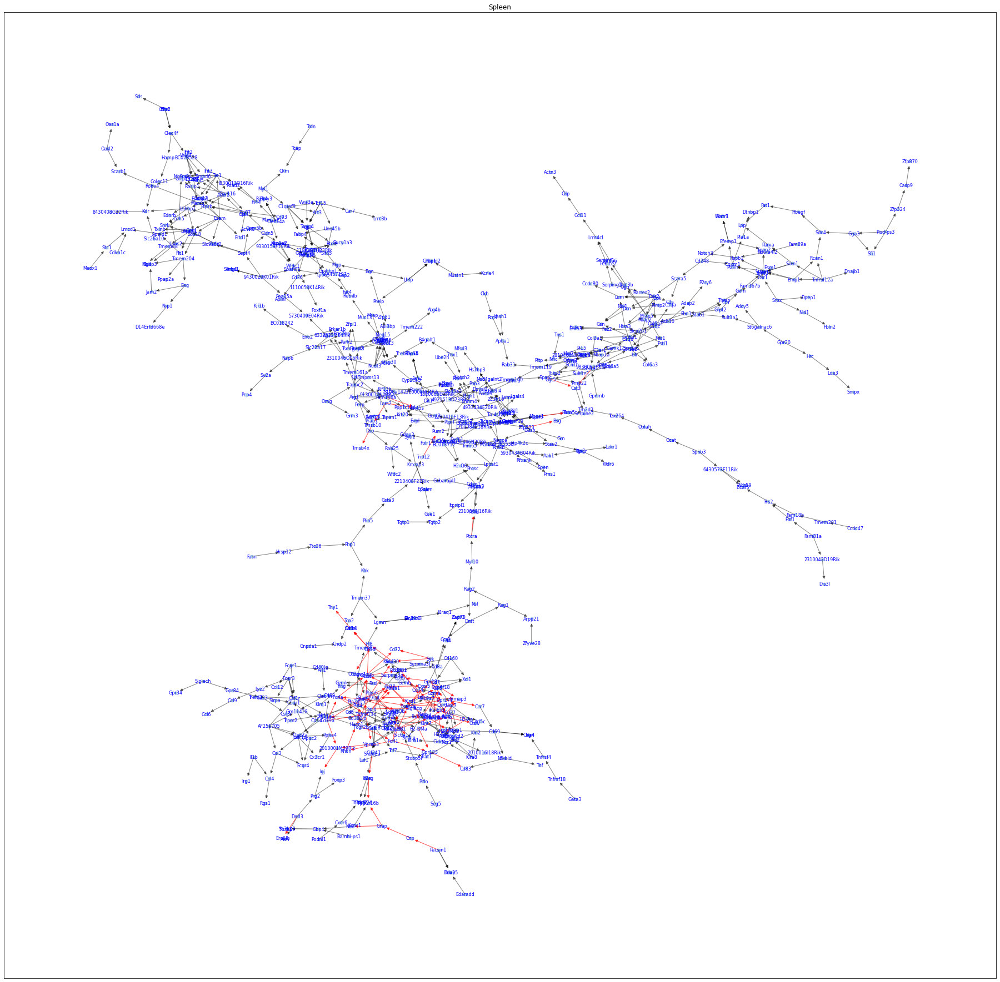

31 / 728


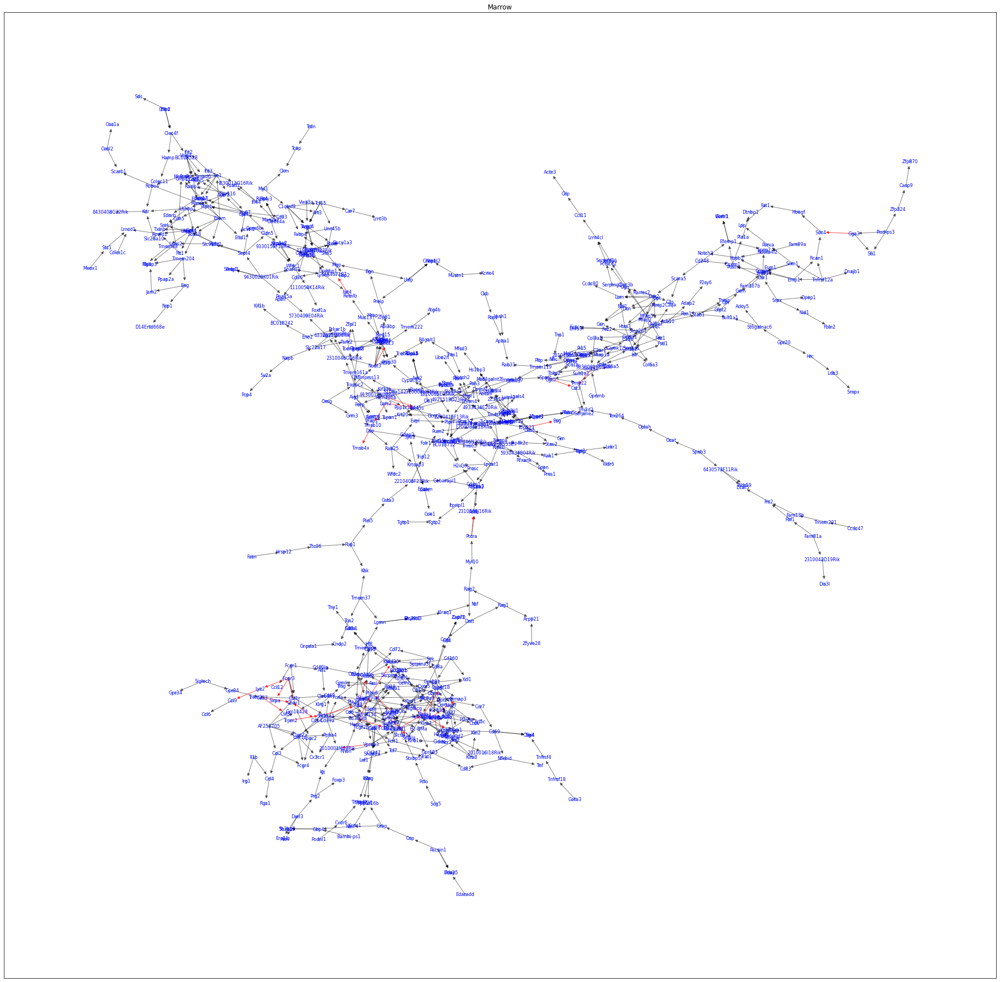

In [36]:
pos=None
for target in ecv_list:
    df2_ecv=df_ecv[['Parent', 'Child',target]]
    df2_ecv=df2_ecv[df2_ecv[target].abs()>0.5]
    edge_ecv_list=[]
    for i,e in df2_ecv.iterrows():
        edge_ecv_list.append((e['Parent'],e['Child']))
    ##
    basal_g_list=[]
    ecv_g_list=[]
    for e in target_G_list[0].edges:
        if e in edge_ecv_list:
            ecv_g_list.append(e)
        else:
            basal_g_list.append(e)
    print(len(ecv_g_list),"/",len(basal_g_list))
    S=target_G_list[0]
    if pos is None:
        pos=nx.kamada_kawai_layout(S)
    ## plot
    plt.figure(figsize=(32,32))
    nx.draw_networkx_nodes(S, pos, node_shape='.',node_size=100,alpha=0.3,)
    #nx.draw_networkx_edges(G, pos, edgelist=basal_edge_list,alpha=0.1, edge_cmap=plt.cm.Reds)
    nx.draw_networkx_edges(S, pos, edgelist=basal_g_list, alpha=0.5)
    nx.draw_networkx_edges(S, pos, edgelist=ecv_g_list, alpha=0.7, edge_color="r",edge_cmap=plt.cm.Reds)
    nx.draw_networkx_labels(S, pos,font_size=8, font_color="blue")
    target_title=target.split(":")[1].split(".")[0]
    plt.title(target_title)
    filename ="ECv_"+target_title+".png"
    plt.savefig(filename)
    plt.show()
    

In [50]:
import numpy as np
import pandas as pd

df_ecv2=pd.read_csv("AD/wt_ad_ecv.txt",sep="\t")
df_ecv2["ECv:dECv"]=(df_ecv2["ECv:AD"]-df_ecv2["ECv:WT"]).abs()
df_ecv2

,Parent,Child,id,parent.id,child.id,edgeScore,BS.Prob,BS.Direction,bspline,gain,...,child.type,parent.hubness,child.hubness,parent.BS.HubIndex,child.BS.HubIndex,parent.mean,child.mean,parent.variance,child.variance,ECv:dECv
0,Tie1,Sox17,1,1563,1,0.097,0.097,0.783505,0.0008057:1.1624292:-0.0208376:0.0139739:0.057...,55.194766,...,real,14,5,2.432,0.708,0.002259,0.000997,0.001651,0.001039,0.709926
1,Rasip1,Sox17,2,2045,1,0.114,0.114,0.570175,0.0079438:1.0478846:-0.0323561:-0.0038756:0.02...,41.158515,...,real,8,5,0.849,0.708,0.010341,0.000997,0.004411,0.001039,0.657052
2,Esam,Sox17,3,2329,1,0.536,0.536,0.936567,0.0065743:1.5823585:-0.0180397:0.0017182:0.041...,43.815886,...,real,16,5,2.838,0.708,0.000671,0.000997,0.002392,0.001039,0.664407
3,Ube2c,Mrpl15,4,1323,2,0.229,0.229,0.886463,0.0104265:0.9490240:0.1066300:0.2234706:0.3351...,16.788183,...,real,9,8,1.799,0.903,0.000000,0.000000,0.000611,0.002255,0.306831
4,Pmf1,Mrpl15,5,1393,2,0.322,0.322,0.881988,0.0745607:0.9769841:0.1878400:0.2374250:0.2812...,19.302089,...,real,5,8,0.928,0.903,0.000000,0.000000,0.002168,0.002255,0.372515
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12071,Jmjd8,Tmsb4x,12072,928,2488,0.053,0.053,0.943396,0.1519452:0.7185136:1.2109350:1.1300381:1.0491...,12.291677,...,real,8,2,0.960,0.334,0.000000,0.000000,0.001419,0.020599,0.935321
12072,Zfp523,Tmsb4x,12073,935,2488,0.106,0.106,0.962264,0.0920120:0.6417622:1.7267691:1.6484926:1.5698...,10.453787,...,real,15,2,1.351,0.334,0.000221,0.000000,0.000787,0.020599,1.360529
12073,Notch2,Tmsb4x,12074,1436,2488,0.097,0.097,0.958763,0.0794185:1.1079149:0.6170079:0.7863205:0.9512...,10.900811,...,real,2,2,0.748,0.334,0.000000,0.000000,0.005672,0.020599,0.366133
12074,Uox,Tmsb4x,12075,1487,2488,0.054,0.054,0.814815,0.0004973:2.0619171:4.8456120:1.6401681:-1.234...,13.763947,...,real,2,2,0.582,0.334,0.000162,0.000000,0.000502,0.020599,0.000000


In [48]:
df_ecv2.columns

Index(['Parent', 'Child', 'id', 'parent.id', 'child.id', 'edgeScore',
       'BS.Prob', 'BS.Direction', 'bspline', 'gain', 'ECv:WT', 'ECv:AD',
       'parent.type', 'child.type', 'parent.hubness', 'child.hubness',
       'parent.BS.HubIndex', 'child.BS.HubIndex', 'parent.mean', 'child.mean',
       'parent.variance', 'child.variance', 'dECv'],
      dtype='object')

335 / 424


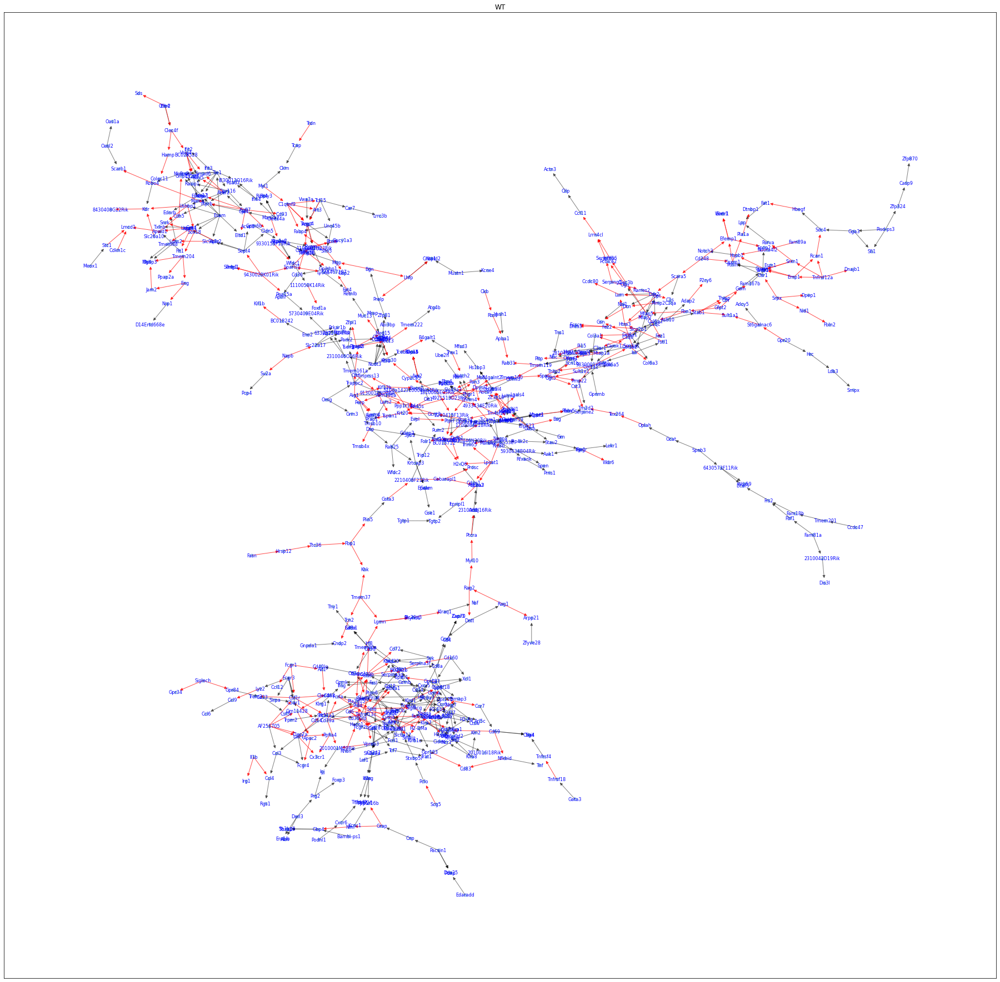

329 / 430


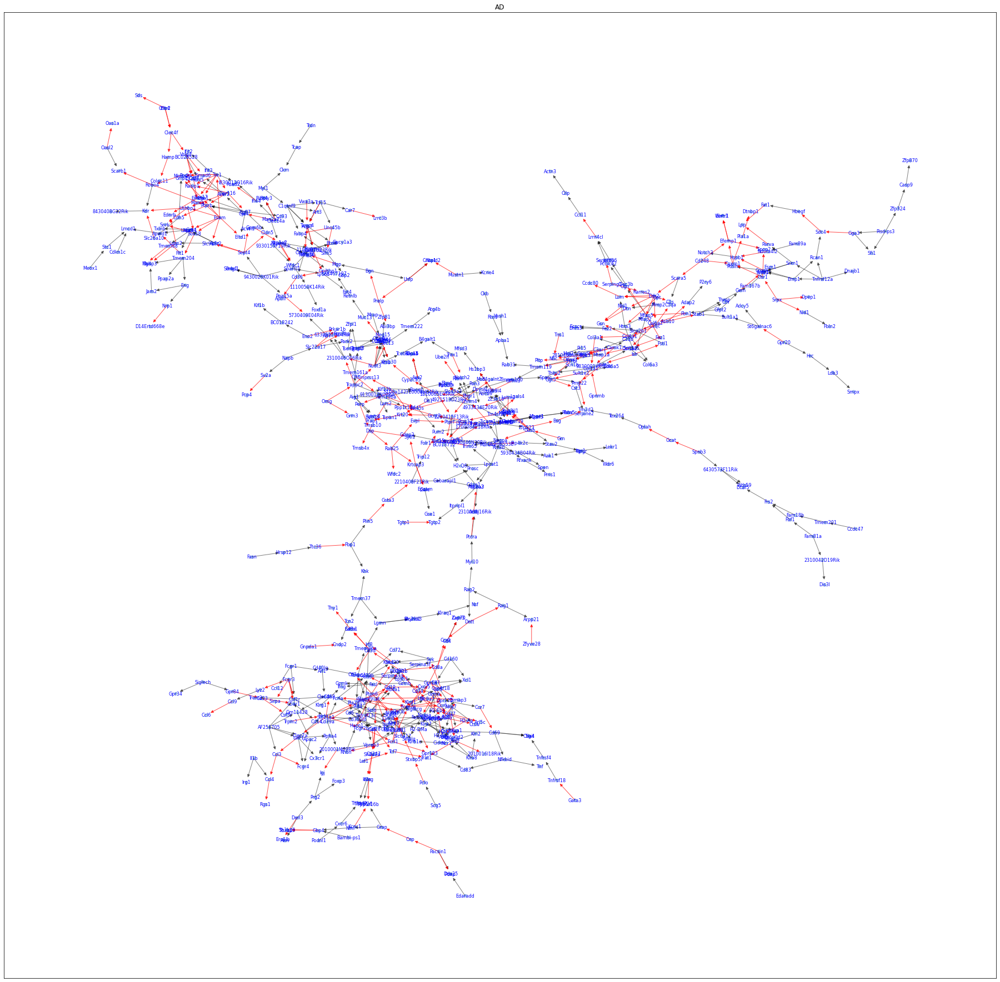

In [39]:
for target in ['ECv:WT', 'ECv:AD']:
    df2_ecv=df_ecv2[['Parent', 'Child',target]]
    df2_ecv=df2_ecv[df2_ecv[target].abs()>0.5]
    edge_ecv_list=[]
    for i,e in df2_ecv.iterrows():
        edge_ecv_list.append((e['Parent'],e['Child']))
    ##
    basal_g_list=[]
    ecv_g_list=[]
    for e in target_G_list[0].edges:
        if e in edge_ecv_list:
            ecv_g_list.append(e)
        else:
            basal_g_list.append(e)
    print(len(ecv_g_list),"/",len(basal_g_list))
    S=target_G_list[0]
    if pos is None:
        pos=nx.kamada_kawai_layout(S)
    ## plot
    plt.figure(figsize=(32,32))
    nx.draw_networkx_nodes(S, pos, node_shape='.',node_size=100,alpha=0.3,)
    #nx.draw_networkx_edges(G, pos, edgelist=basal_edge_list,alpha=0.1, edge_cmap=plt.cm.Reds)
    nx.draw_networkx_edges(S, pos, edgelist=basal_g_list, alpha=0.5)
    nx.draw_networkx_edges(S, pos, edgelist=ecv_g_list, alpha=0.7, edge_color="r",edge_cmap=plt.cm.Reds)
    nx.draw_networkx_labels(S, pos,font_size=8, font_color="blue")
    target_title=target.split(":")[1].split(".")[0]
    plt.title(target_title)
    filename ="ECv_"+target_title+".png"
    plt.savefig(filename)
    plt.show()
    

(-2.0, 2.0)

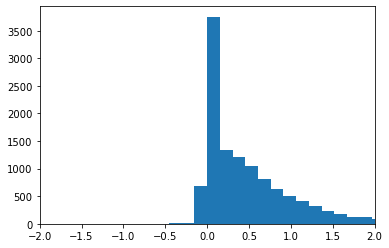

In [40]:
x=np.ravel(df_ecv2["ECv:WT"].values)
plt.hist(x,bins=300)
plt.xlim(-2,2)

(array([3.39e+03, 3.60e+01, 4.00e+01, 4.60e+01, 5.10e+01, 7.40e+01,
        7.60e+01, 1.08e+02, 1.03e+02, 1.22e+02, 1.42e+02, 1.44e+02,
        1.28e+02, 1.39e+02, 1.46e+02, 1.31e+02, 1.36e+02, 1.58e+02,
        1.34e+02, 1.61e+02, 1.59e+02, 1.35e+02, 1.50e+02, 1.60e+02,
        1.34e+02, 1.10e+02, 1.26e+02, 1.08e+02, 1.09e+02, 1.09e+02,
        1.05e+02, 1.15e+02, 9.30e+01, 1.01e+02, 1.08e+02, 1.09e+02,
        9.30e+01, 1.01e+02, 1.06e+02, 1.21e+02, 1.07e+02, 9.10e+01,
        1.15e+02, 9.90e+01, 9.40e+01, 9.00e+01, 8.60e+01, 8.30e+01,
        6.80e+01, 8.10e+01, 8.80e+01, 6.60e+01, 8.10e+01, 7.20e+01,
        6.30e+01, 6.40e+01, 8.00e+01, 4.80e+01, 6.80e+01, 6.10e+01,
        8.10e+01, 7.50e+01, 5.50e+01, 5.90e+01, 5.90e+01, 5.10e+01,
        6.10e+01, 5.50e+01, 5.70e+01, 5.20e+01, 4.80e+01, 4.80e+01,
        4.70e+01, 4.60e+01, 4.10e+01, 3.50e+01, 3.50e+01, 3.90e+01,
        4.40e+01, 3.00e+01, 3.70e+01, 3.90e+01, 3.90e+01, 2.60e+01,
        2.40e+01, 3.30e+01, 3.80e+01, 3.30e+01, 

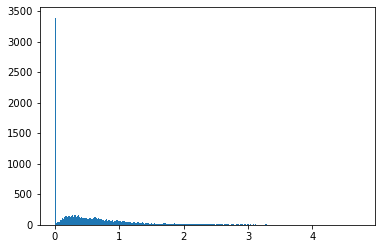

In [44]:
x=np.ravel(np.abs(df_ecv2["ECv:AD"].values-df_ecv2["ECv:WT"].values))
plt.hist(x,bins=300)
#plt.xlim(-2,2)


72 / 687


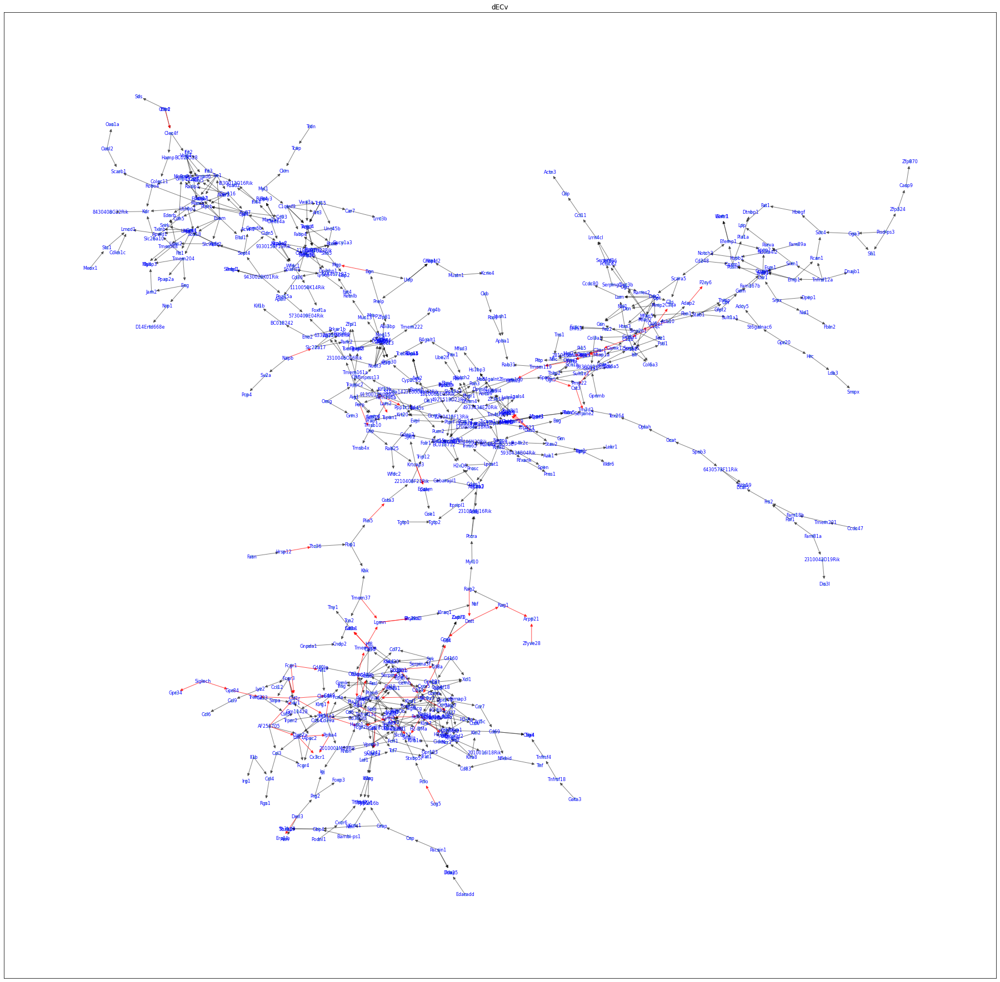

In [51]:

for target in ['ECv:dECv']:
    df2_ecv=df_ecv2[['Parent', 'Child',target]]
    df2_ecv=df2_ecv[df2_ecv[target].abs()>2.0]
    edge_ecv_list=[]
    for i,e in df2_ecv.iterrows():
        edge_ecv_list.append((e['Parent'],e['Child']))
    ##
    basal_g_list=[]
    ecv_g_list=[]
    for e in target_G_list[0].edges:
        if e in edge_ecv_list:
            ecv_g_list.append(e)
        else:
            basal_g_list.append(e)
    print(len(ecv_g_list),"/",len(basal_g_list))
    S=target_G_list[0]
    if pos is None:
        pos=nx.kamada_kawai_layout(S)
    ## plot
    plt.figure(figsize=(32,32))
    nx.draw_networkx_nodes(S, pos, node_shape='.',node_size=100,alpha=0.3,)
    #nx.draw_networkx_edges(G, pos, edgelist=basal_edge_list,alpha=0.1, edge_cmap=plt.cm.Reds)
    nx.draw_networkx_edges(S, pos, edgelist=basal_g_list, alpha=0.5)
    nx.draw_networkx_edges(S, pos, edgelist=ecv_g_list, alpha=0.7, edge_color="r",edge_cmap=plt.cm.Reds)
    nx.draw_networkx_labels(S, pos,font_size=8, font_color="blue")
    target_title=target.split(":")[1].split(".")[0]
    plt.title(target_title)
    filename ="ECv_"+target_title+".png"
    plt.savefig(filename)
    plt.show()
    